In [3]:
from multiprocessing import Pool
import os.path
import time
from itertools import repeat

import cv2
import torch
from torch import nn, tensor
from torch.optim.lr_scheduler import CosineAnnealingLR
from torch.utils.tensorboard import SummaryWriter
from torch_geometric.data import DataLoader
from torch_geometric.utils import add_self_loops
import torchmetrics
from dataset.sp_hcc_dataset import HccSuperpixelsDataset, HccSuperpixelsTestDataset
from dataset.sp_hcc_single_dataset import HccSingleSuperpixelsDataset
from loss.fl import focal_loss
from models.gcn import GCN, GCNSimple, GraphNet
from models.graph_sage import GraphSAGE
import numpy as np
import torch.nn.functional as F
from loss_schedule import loss_schedule
from models.graph_transformer import GraphTransformer, Mlp
from models.graph_transformer_pure import Transformer
from utils.utils_single import convert_numpy_img_to_superpixel_graph_2_single, \
    convert_numpy_img_to_superpixel_graph_3_single, cut_patch_stage_2_single, cut_patch_stage_3_single, \
    generate_transformer_input_and_its_groups_id_sequence, get_nodes_group_composition, merge_t_out_and_k_out, \
    multi_process_exec
import logging
import matplotlib.pyplot as plt

from utils.utils_single import draw_graph_attn, normalize
from utils.utils_single import read_points_from_xml

slide_root = '/mnt/s3/lhm/HCC/'
image_root = '/mnt/s3/lhm/HCC_seg_1/'
K = 4
writer = SummaryWriter('./log')
dataset = HccSingleSuperpixelsDataset(root='/mnt/s3/lhm/HCC_Pre/')
# dataset_test = HccSuperpixelsTestDataset(root='data/')
loader = DataLoader(dataset, batch_size=1, shuffle=True)
# loader_test = DataLoader(dataset_test, batch_size=1, shuffle=True)
device = torch.device('cuda:1')
criterion = nn.CrossEntropyLoss()
model1 = GraphNet(c_in=768, hidden_size=256, nc=5).to(device)
transformer1 = Transformer(embed_dim=256, cls=2).to(device)
opt1 = torch.optim.SGD(
    [{"params": model1.parameters(), 'lr': 13e-3}, {"params": transformer1.parameters(), 'lr': 1e-3}])
scheduler1 = CosineAnnealingLR(opt1, T_max=200, eta_min=0)
final_clsfr2 = Mlp(in_features=512, hidden_features=196, out_features=2).to(device)
final_clsfr3 = Mlp(in_features=512, hidden_features=196, out_features=2).to(device)
model2 = GraphNet(c_in=768, hidden_size=256, nc=5).to(device)
graph_transformer_2 = GraphTransformer(cls=5).to(device)
opt2 = torch.optim.SGD(
    [{"params": model2.parameters(), 'lr': 3e-3}, {"params": graph_transformer_2.parameters(), 'lr': 1e-3},
     {"params": final_clsfr2.parameters(), 'lr': 3e-3}])
scheduler2 = CosineAnnealingLR(opt2, T_max=10000, eta_min=0)

model3 = GraphNet(c_in=768, hidden_size=256, nc=5).to(device)
graph_transformer_3 = GraphTransformer(cls=2).to(device)
opt3 = torch.optim.SGD(
    [{"params": model3.parameters(), 'lr': 3e-3}, {"params": graph_transformer_3.parameters(), 'lr': 1e-3},
     {"params": final_clsfr3.parameters(), 'lr': 3e-3}])
scheduler3 = CosineAnnealingLR(opt3, T_max=200, eta_min=0)

model1 = model1.to(device)
transformer1 = transformer1.to(device)
model1.load_state_dict(torch.load('model_save/1.pth'))
transformer1.load_state_dict(torch.load('model_save/tr1.pth'))
# model2 = model2.to(device)
# graph_transformer_2 = graph_transformer_2.to(device)
# model3 = model3.to(device)
# graph_transformer_3 = graph_transformer_3.to(device)
print("model state dict Loaded")

model state dict Loaded


128


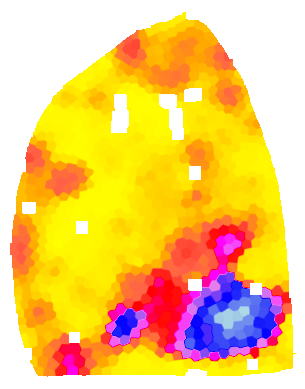

/mnt/s3/lhm/HCC_thumb/1/20130525.png


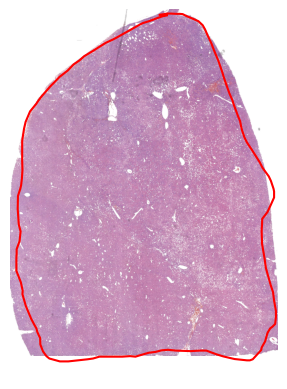

128


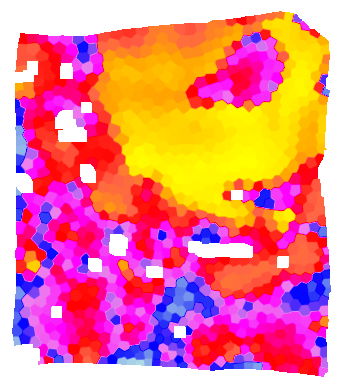

/mnt/s3/lhm/HCC_thumb/1/20200205.png


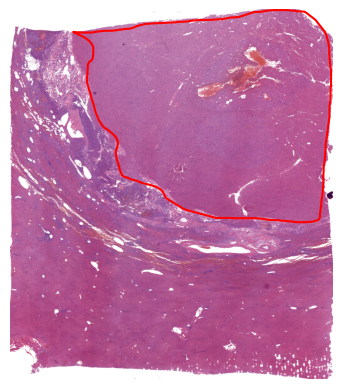

128


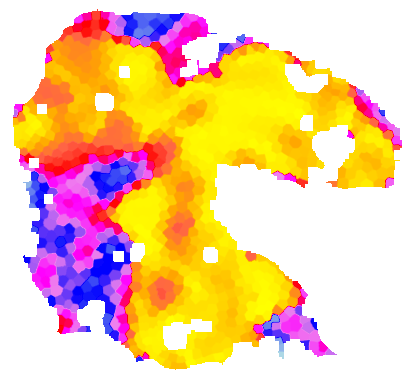

/mnt/s3/lhm/HCC_thumb/3/201365818.png


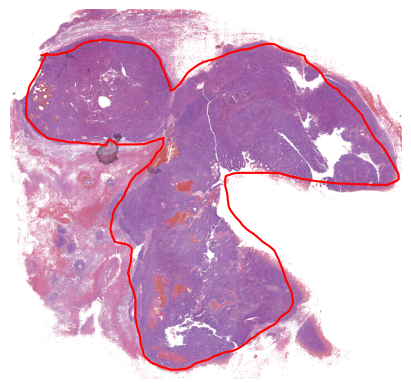

128


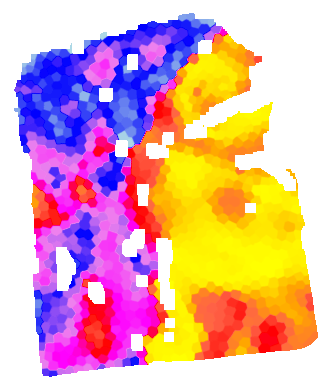

/mnt/s3/lhm/HCC_thumb/1/20124548.png


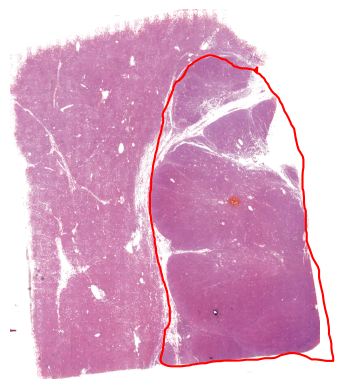

128


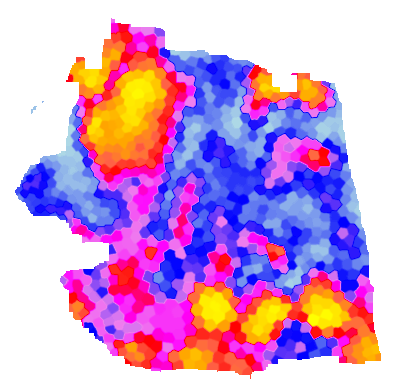

/mnt/s3/lhm/HCC_thumb/0/7M12.png


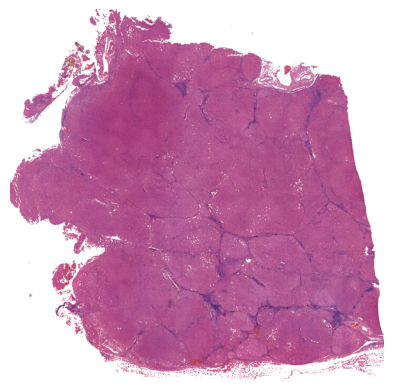

128


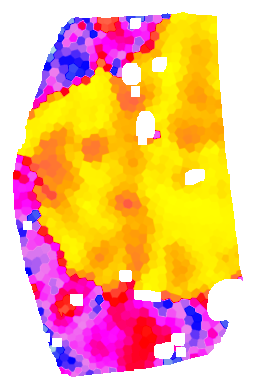

/mnt/s3/lhm/HCC_thumb/1/202006212.png


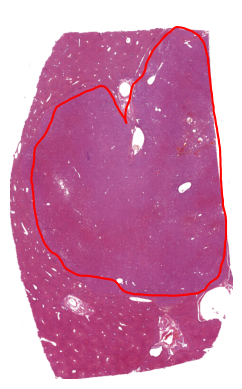

128


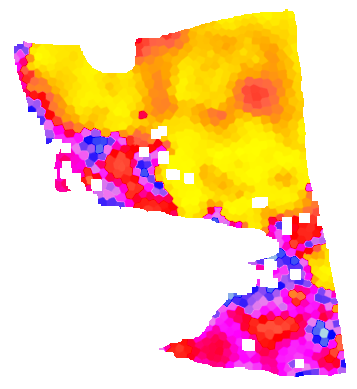

/mnt/s3/lhm/HCC_thumb/1/20191009.png


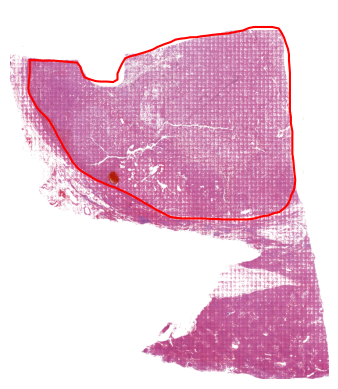

128


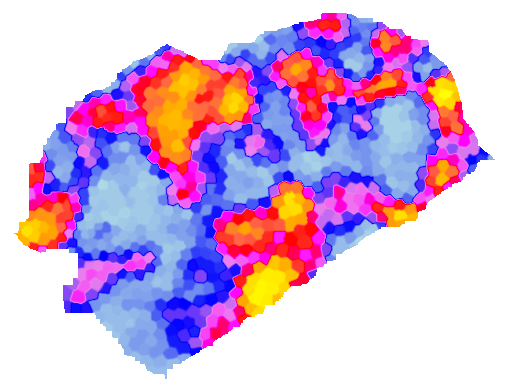

/mnt/s3/lhm/HCC_thumb/0/7M01.png


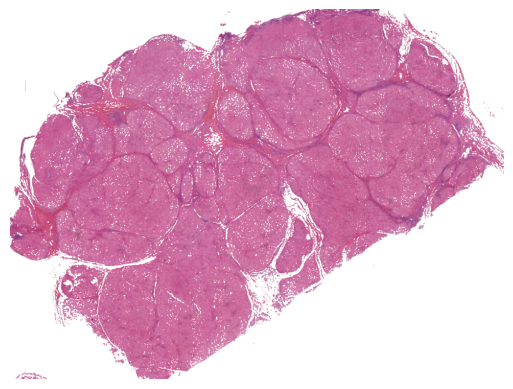

128


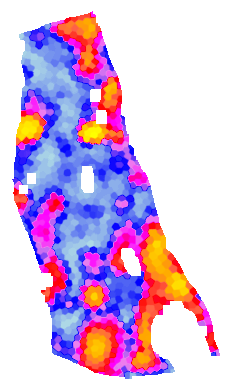

/mnt/s3/lhm/HCC_thumb/0/6M12.png


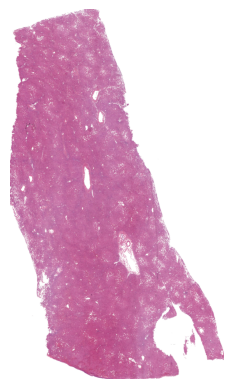

128


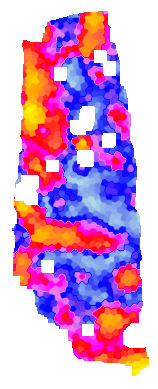

/mnt/s3/lhm/HCC_thumb/0/7M17.png


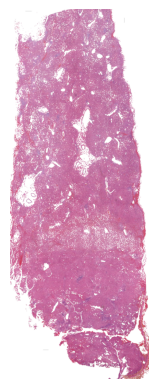

128


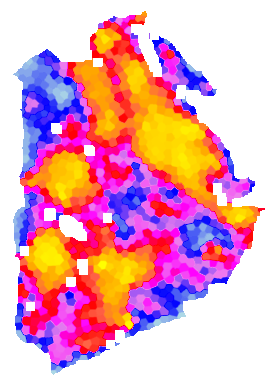

/mnt/s3/lhm/HCC_thumb/4/202004521.png


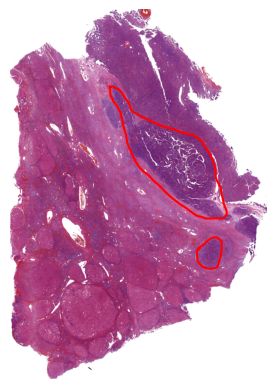

128


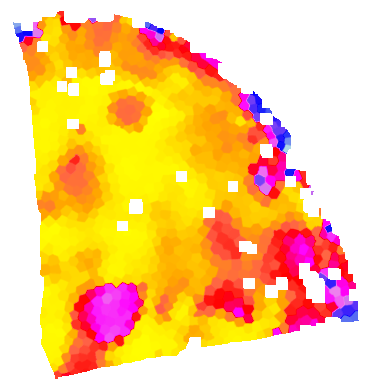

/mnt/s3/lhm/HCC_thumb/1/201323914.png


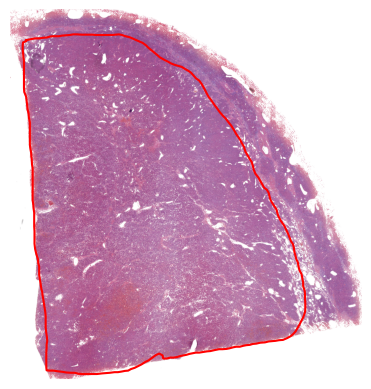

128


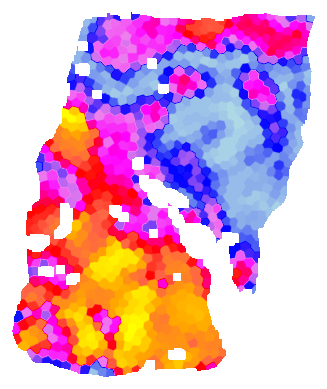

/mnt/s3/lhm/HCC_thumb/1/20110134.png


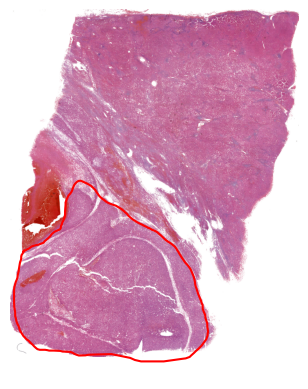

128


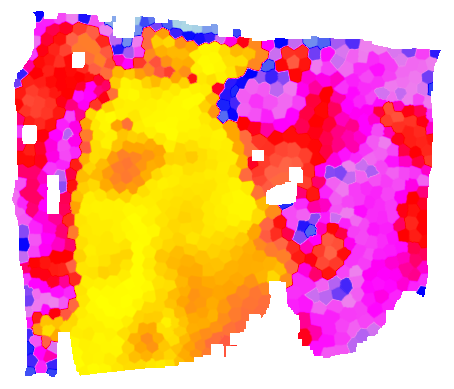

/mnt/s3/lhm/HCC_thumb/1/201122287.png


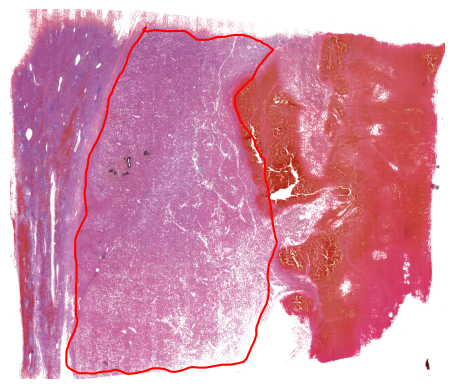

128


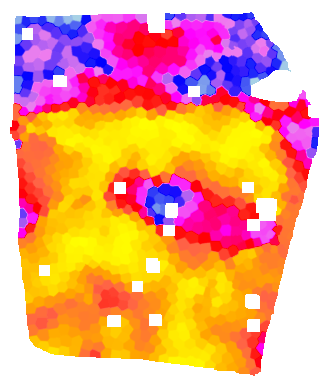

/mnt/s3/lhm/HCC_thumb/1/20190018.png


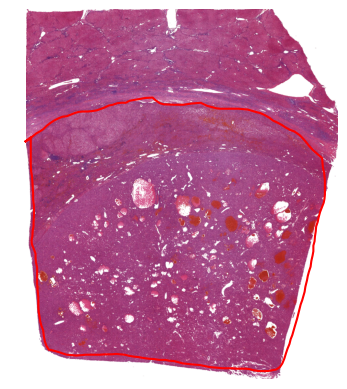

128


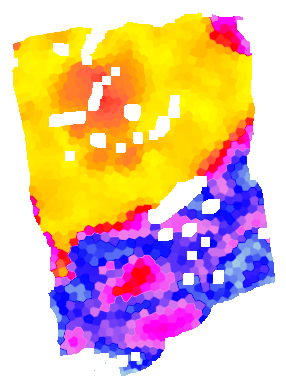

/mnt/s3/lhm/HCC_thumb/3/20130793.png


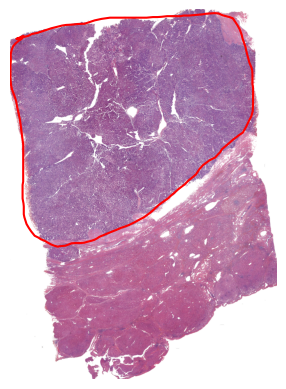

128


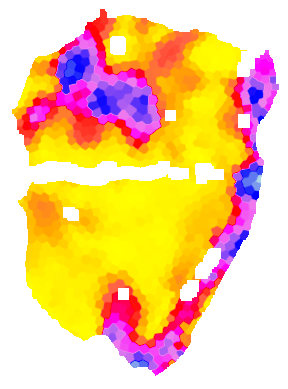

/mnt/s3/lhm/HCC_thumb/4/201362995.png


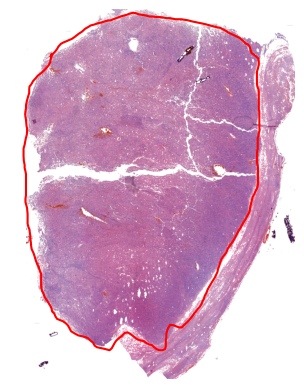

128


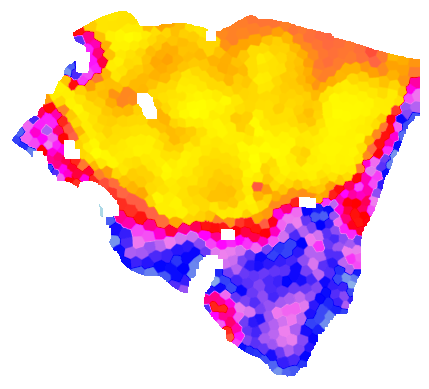

/mnt/s3/lhm/HCC_thumb/2/201238272.png


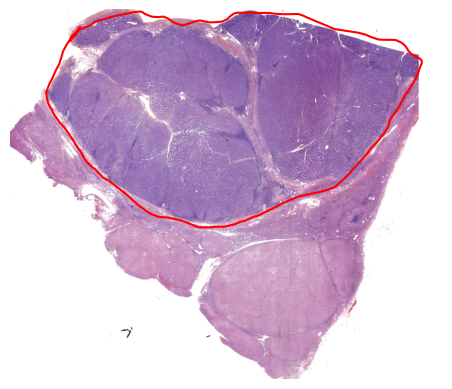

128


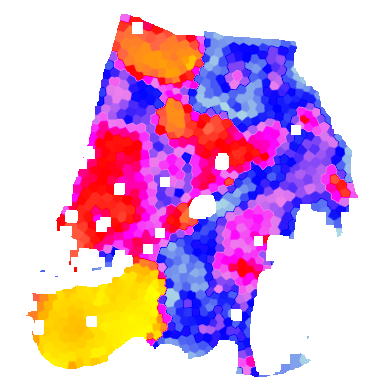

/mnt/s3/lhm/HCC_thumb/3/201228058.png


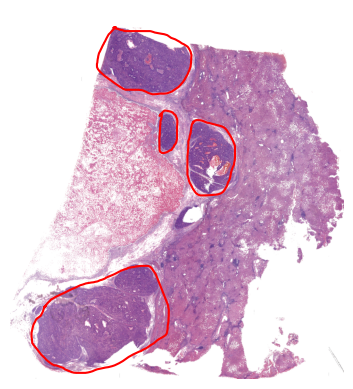

128


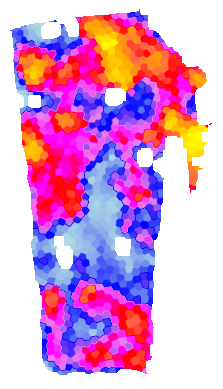

/mnt/s3/lhm/HCC_thumb/0/6M09.png


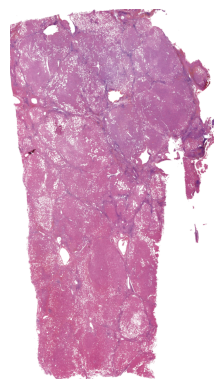

128


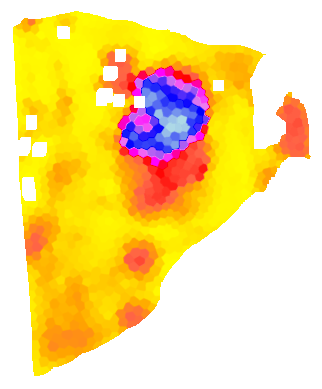

/mnt/s3/lhm/HCC_thumb/1/20131297.png


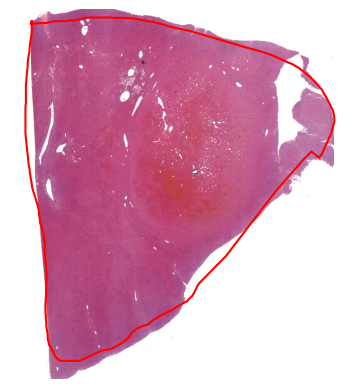

128


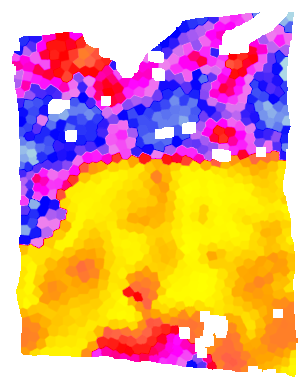

/mnt/s3/lhm/HCC_thumb/1/20125722.png


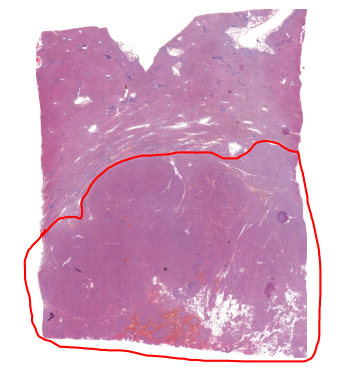

128


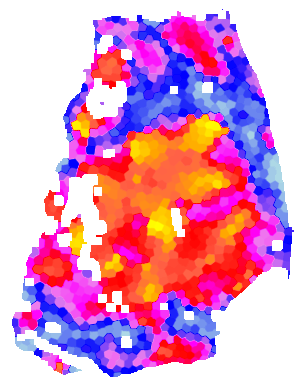

/mnt/s3/lhm/HCC_thumb/3/201125513.png


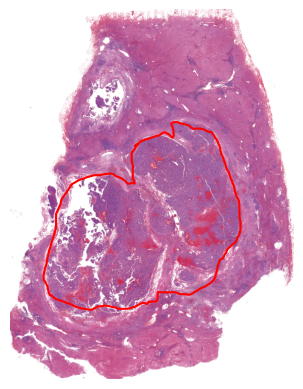

128


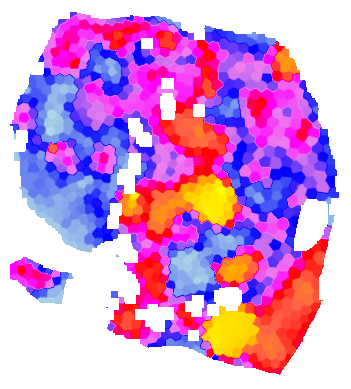

/mnt/s3/lhm/HCC_thumb/2/201259490.png


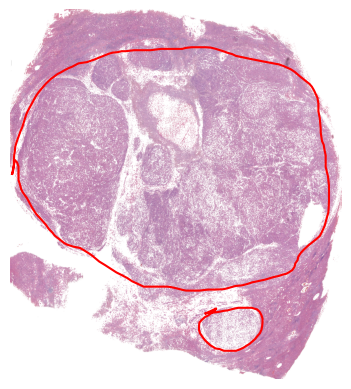

128


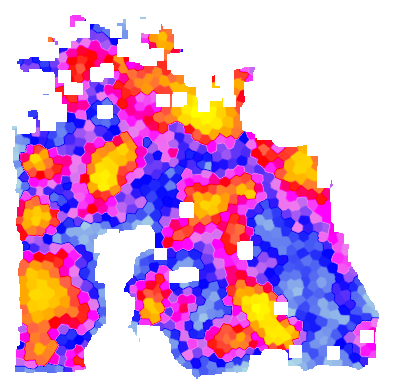

/mnt/s3/lhm/HCC_thumb/0/6M10.png


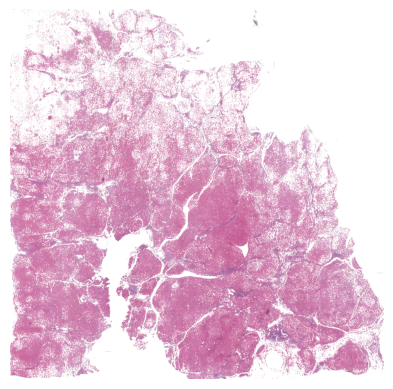

128


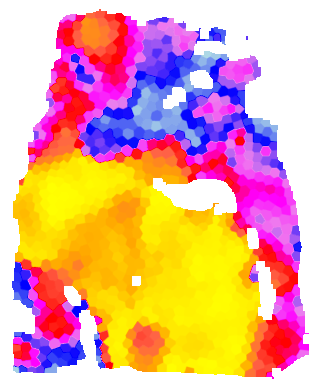

/mnt/s3/lhm/HCC_thumb/2/201360404.png


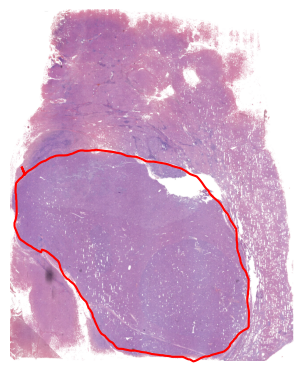

128


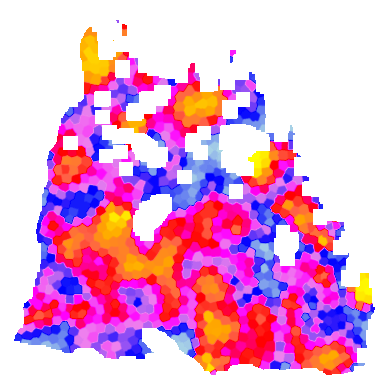

/mnt/s3/lhm/HCC_thumb/0/6M14.png


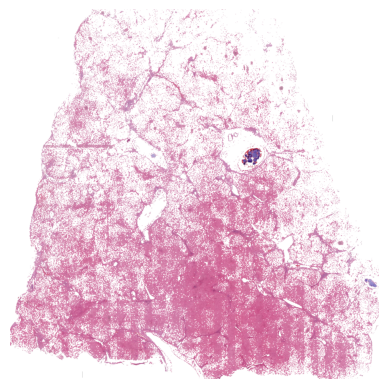

128


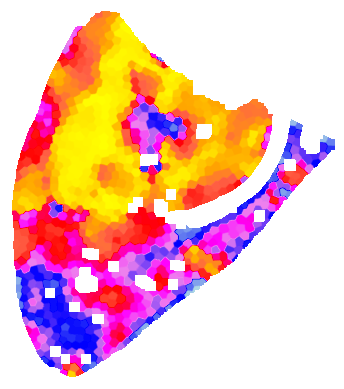

/mnt/s3/lhm/HCC_thumb/1/201257440.png


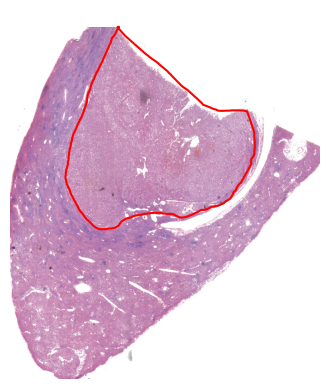

128


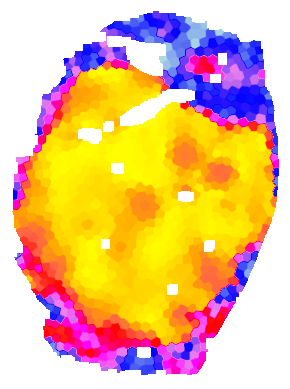

/mnt/s3/lhm/HCC_thumb/2/201351719.png


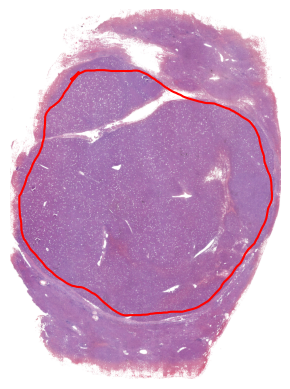

128


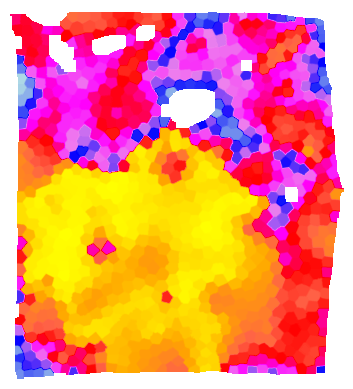

/mnt/s3/lhm/HCC_thumb/1/20200505.png


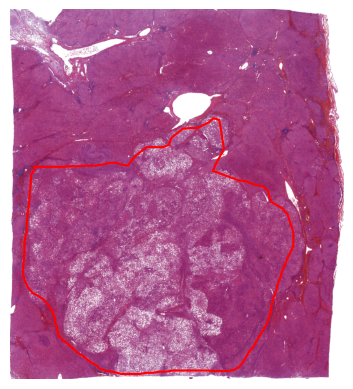

128


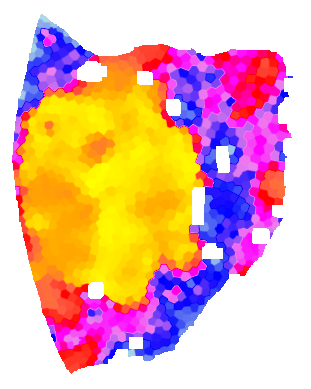

/mnt/s3/lhm/HCC_thumb/1/20191133.png


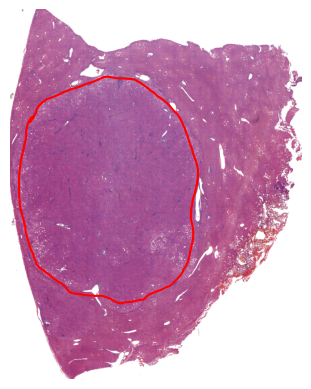

128


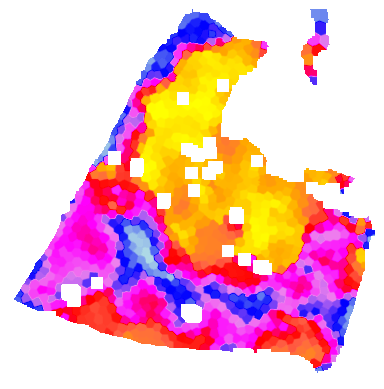

/mnt/s3/lhm/HCC_thumb/2/20132864.png


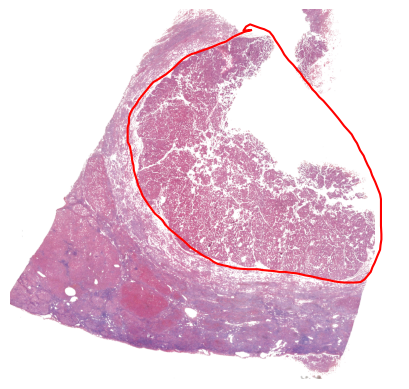

128


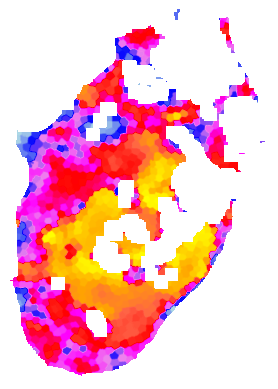

/mnt/s3/lhm/HCC_thumb/4/201900280.png


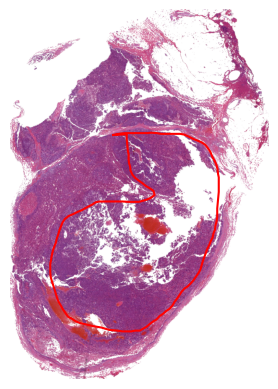

128


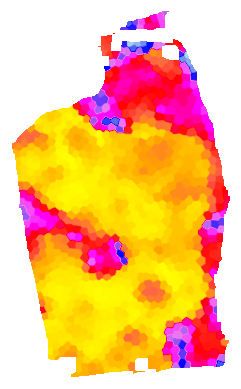

/mnt/s3/lhm/HCC_thumb/4/20190981.png


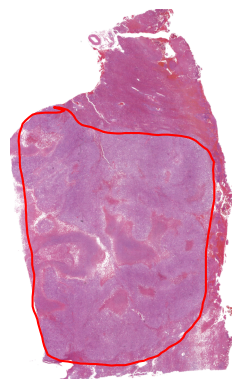

128


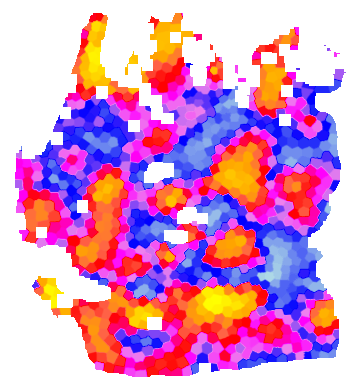

/mnt/s3/lhm/HCC_thumb/0/6M11.png


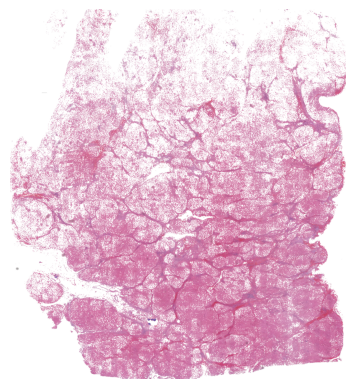

128


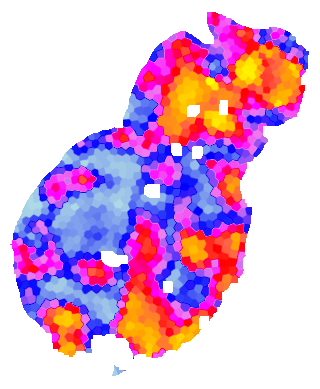

/mnt/s3/lhm/HCC_thumb/0/6M15.png


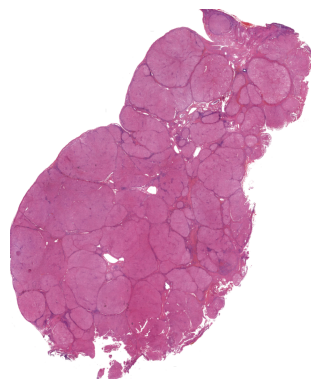

128


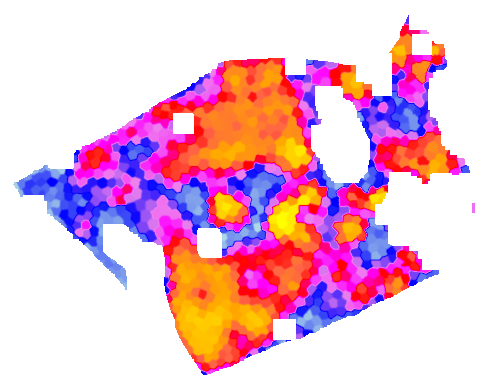

/mnt/s3/lhm/HCC_thumb/0/6M18.png


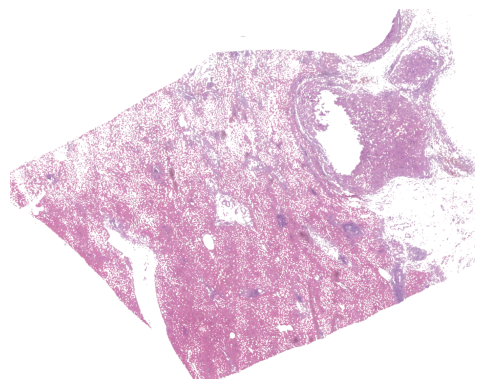

128


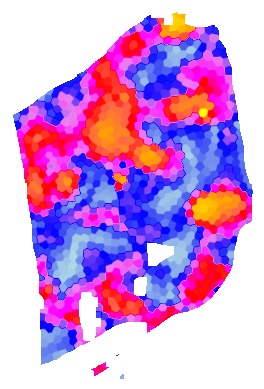

/mnt/s3/lhm/HCC_thumb/0/6M05.png


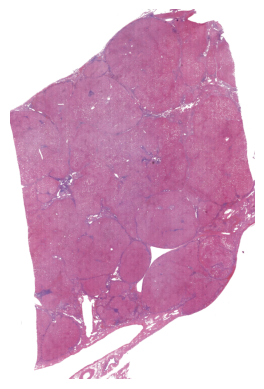

128


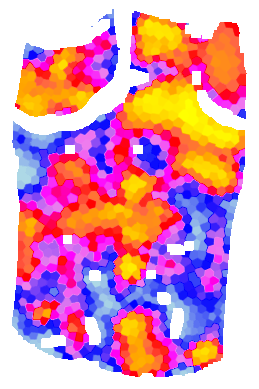

/mnt/s3/lhm/HCC_thumb/3/2M15.png
'NoneType' object is not subscriptable
128


[ WARN:0@428.366] global loadsave.cpp:241 findDecoder imread_('/mnt/s3/lhm/HCC_thumb/3/2M15.png'): can't open/read file: check file path/integrity


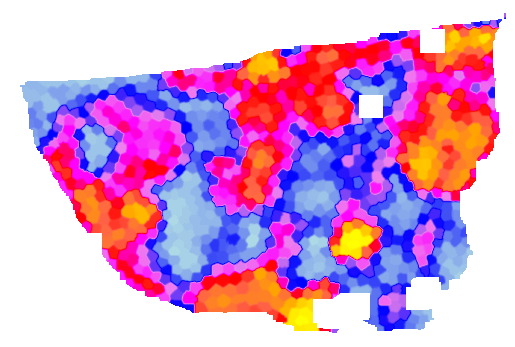

/mnt/s3/lhm/HCC_thumb/0/6M03.png


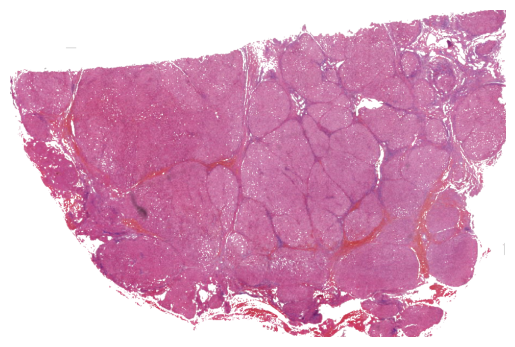

128


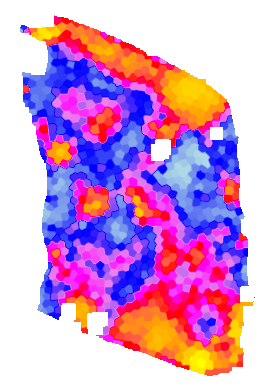

/mnt/s3/lhm/HCC_thumb/0/7M10.png


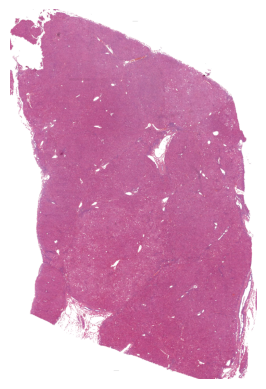

128


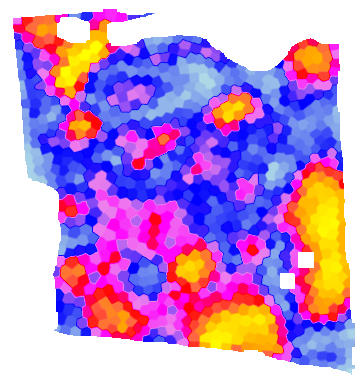

/mnt/s3/lhm/HCC_thumb/0/7M22.png


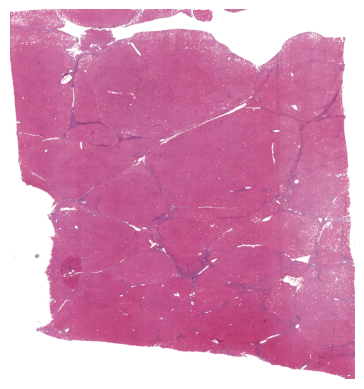

128


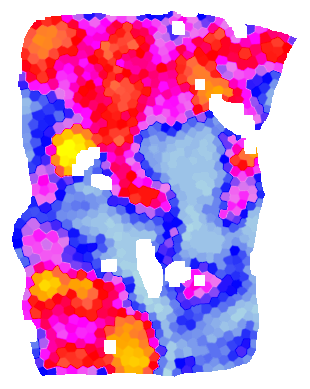

/mnt/s3/lhm/HCC_thumb/0/6M02.png


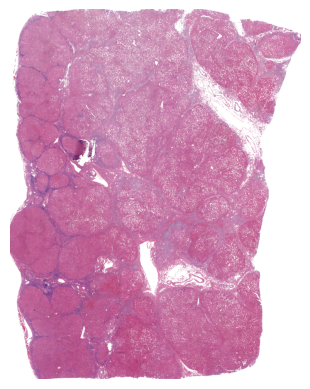

128


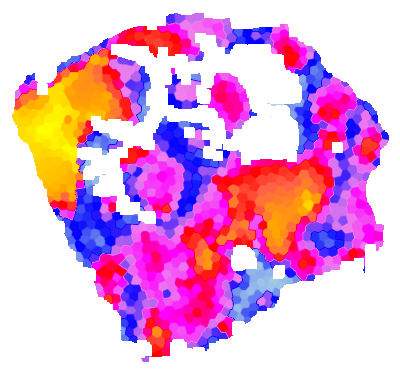

/mnt/s3/lhm/HCC_thumb/2/201361220.png


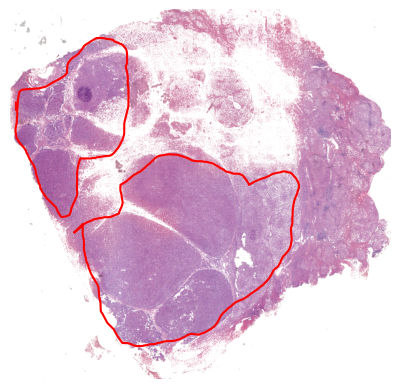

128


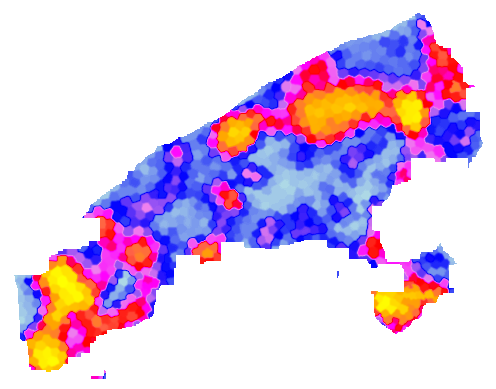

/mnt/s3/lhm/HCC_thumb/0/7M14.png


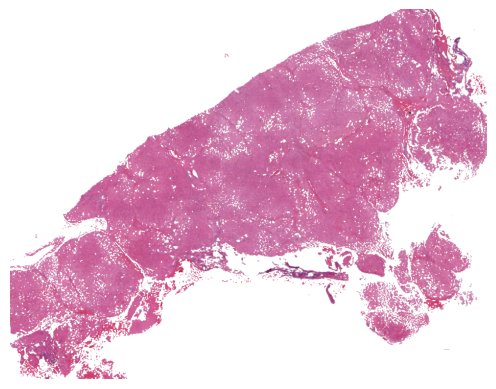

128


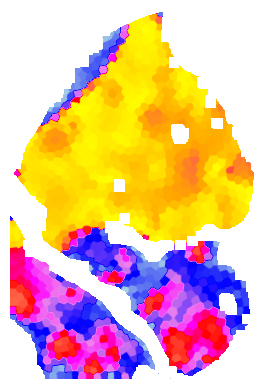

/mnt/s3/lhm/HCC_thumb/2/20136152.png


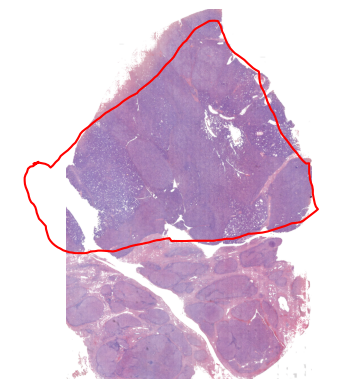

128


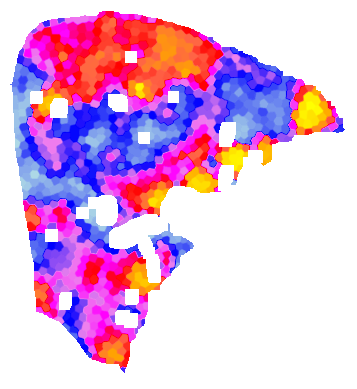

/mnt/s3/lhm/HCC_thumb/0/6M17.png


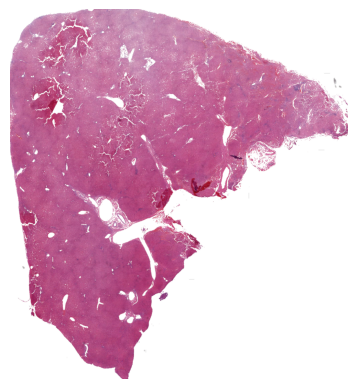

128


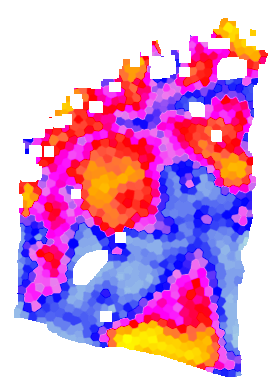

/mnt/s3/lhm/HCC_thumb/0/7M09.png


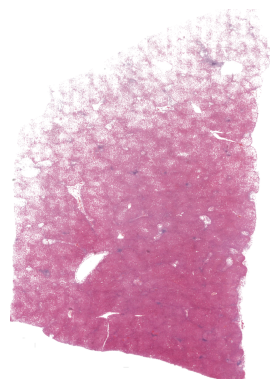

128


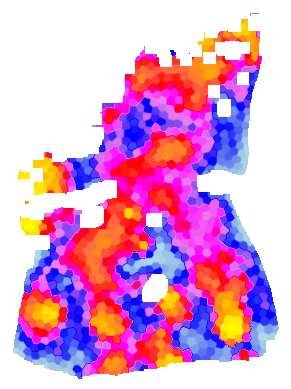

/mnt/s3/lhm/HCC_thumb/0/6M07.png


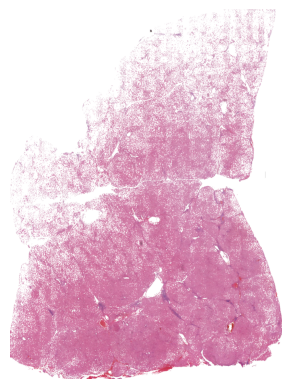

128


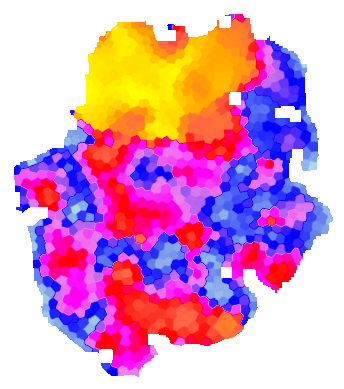

/mnt/s3/lhm/HCC_thumb/2/201247862.png


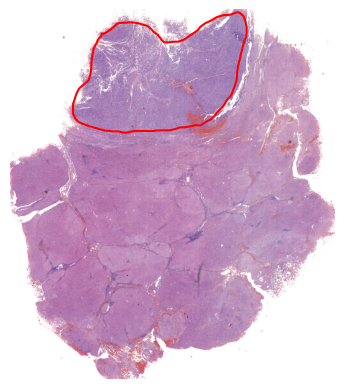

128


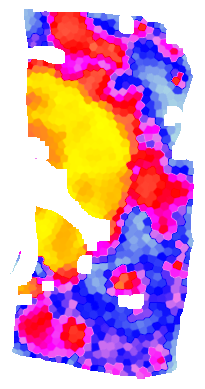

/mnt/s3/lhm/HCC_thumb/2/201212265-5.png


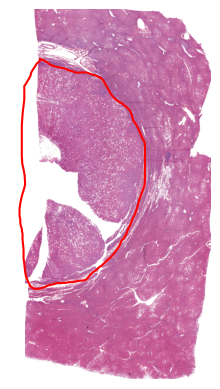

128


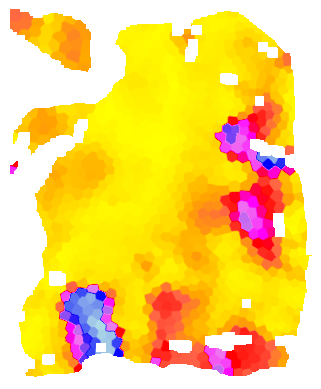

/mnt/s3/lhm/HCC_thumb/3/20120986.png


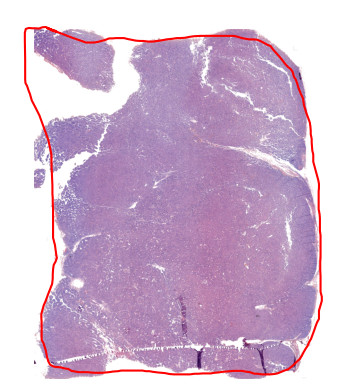

128


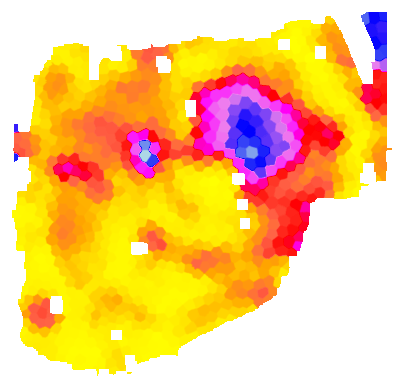

/mnt/s3/lhm/HCC_thumb/2/20114108.png


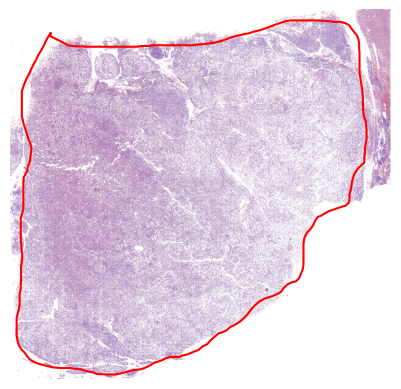

128


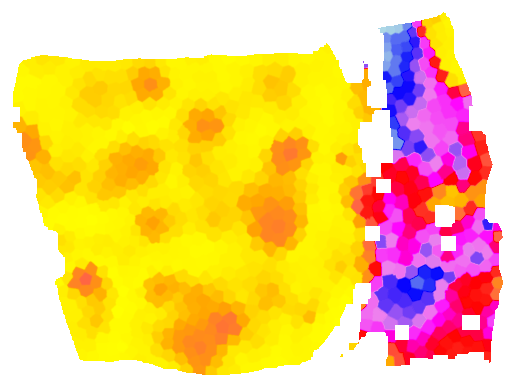

/mnt/s3/lhm/HCC_thumb/2/201136466.png


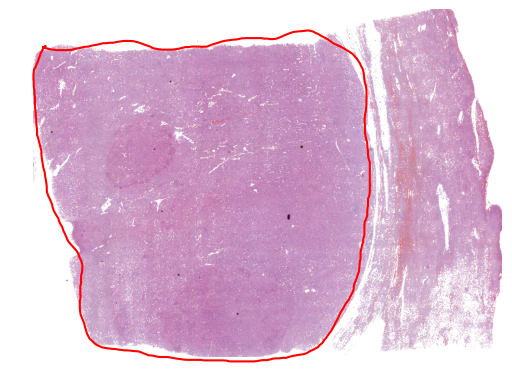

128


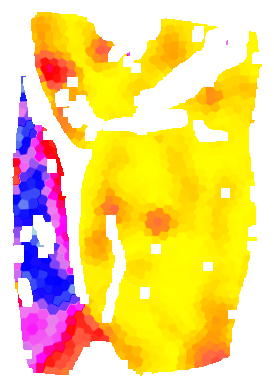

/mnt/s3/lhm/HCC_thumb/1/20115827.png


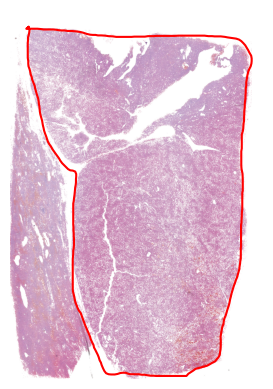

128


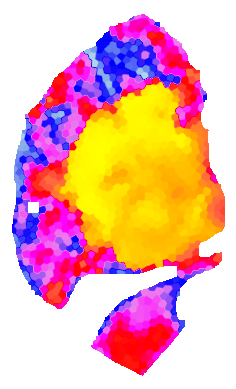

/mnt/s3/lhm/HCC_thumb/1/201908826-4.png


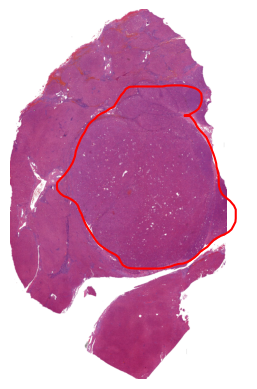

128


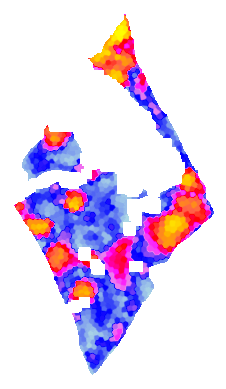

/mnt/s3/lhm/HCC_thumb/0/6M06.png


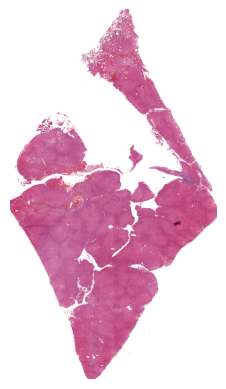

128


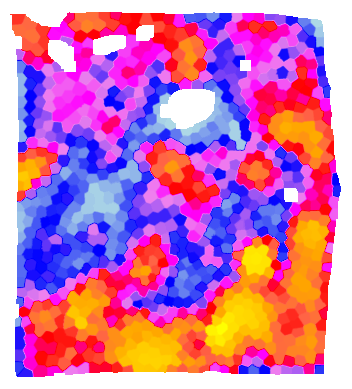

/mnt/s3/lhm/HCC_thumb/0/8M02.png


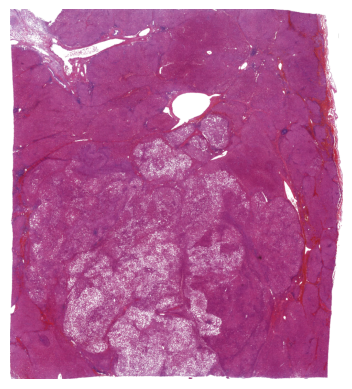

128


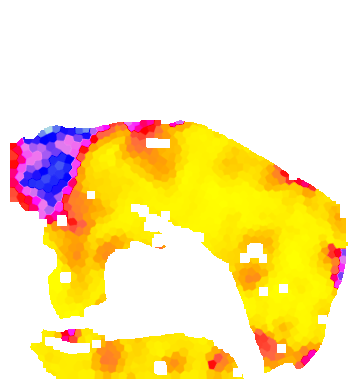

/mnt/s3/lhm/HCC_thumb/2/201338679.png


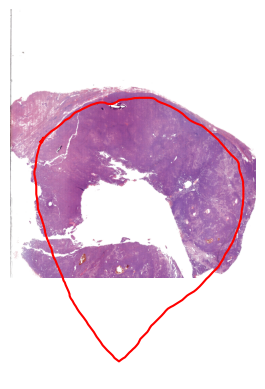

128


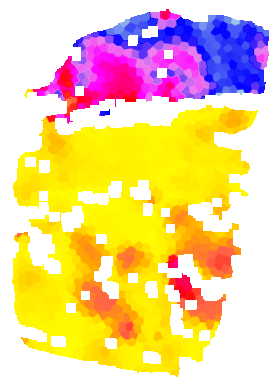

/mnt/s3/lhm/HCC_thumb/2/2012051-7.png


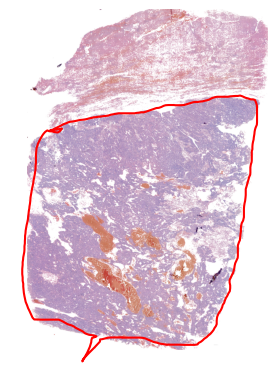

128


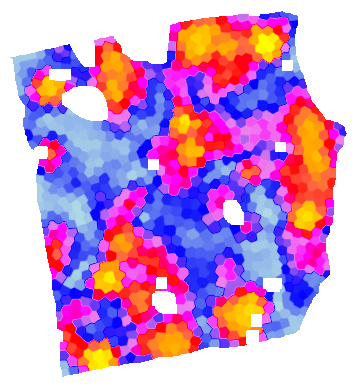

/mnt/s3/lhm/HCC_thumb/0/6M20.png


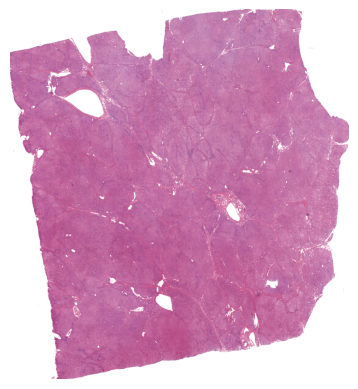

128


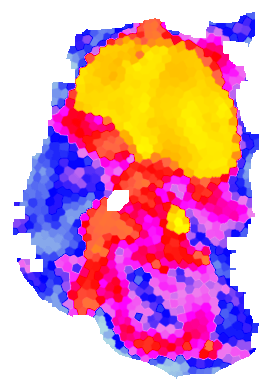

/mnt/s3/lhm/HCC_thumb/3/201360910.png


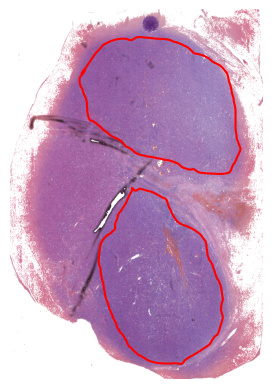

128


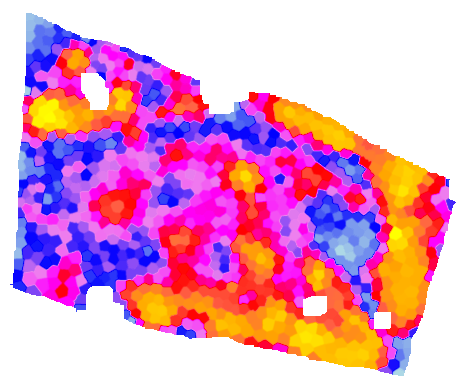

/mnt/s3/lhm/HCC_thumb/0/7M02.png


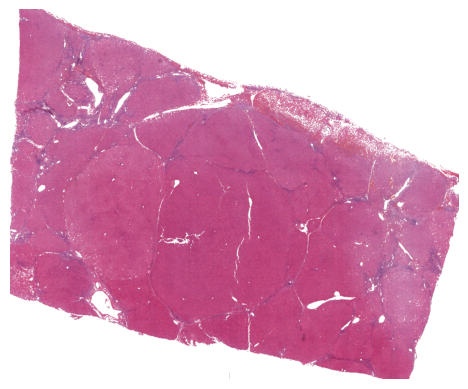

128


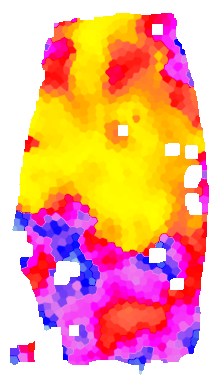

/mnt/s3/lhm/HCC_thumb/1/201208500.png


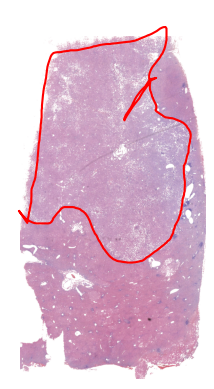

128


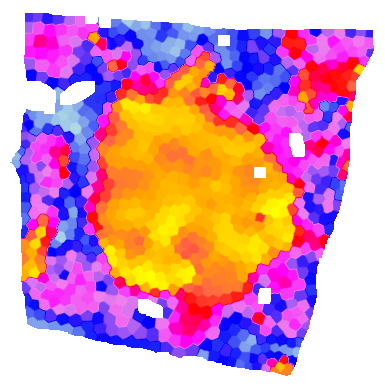

/mnt/s3/lhm/HCC_thumb/3/201114429.png


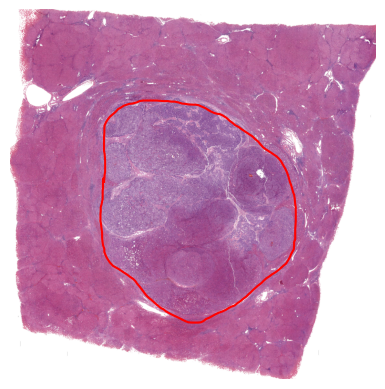

128


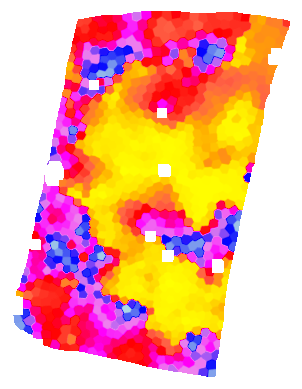

/mnt/s3/lhm/HCC_thumb/1/20200287.png


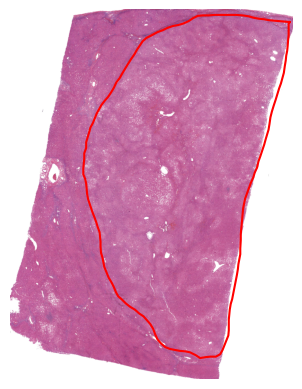

128


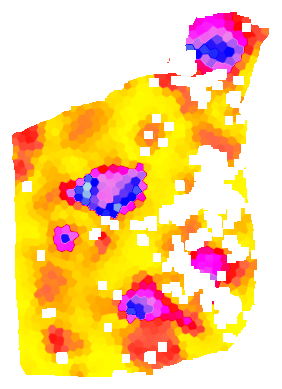

/mnt/s3/lhm/HCC_thumb/3/201221648-3.png


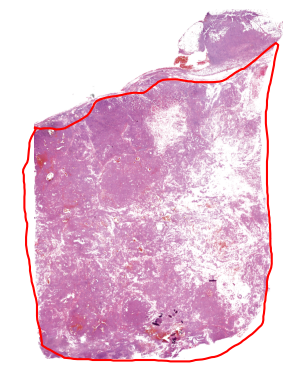

128


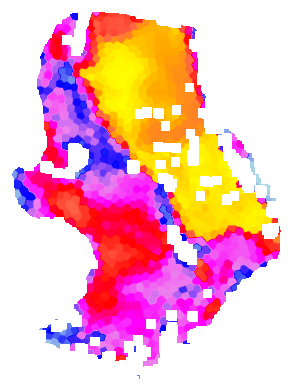

/mnt/s3/lhm/HCC_thumb/2/20130287.png


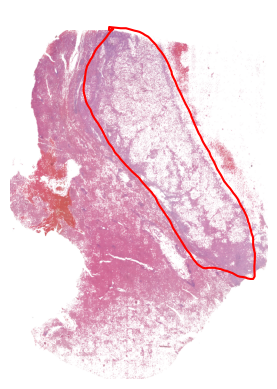

128


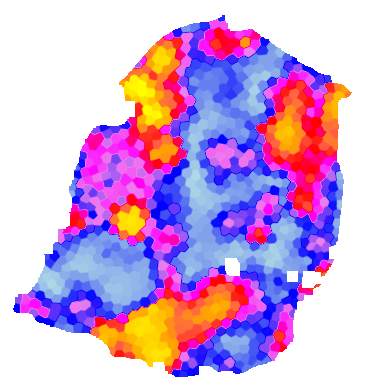

/mnt/s3/lhm/HCC_thumb/0/7M08.png


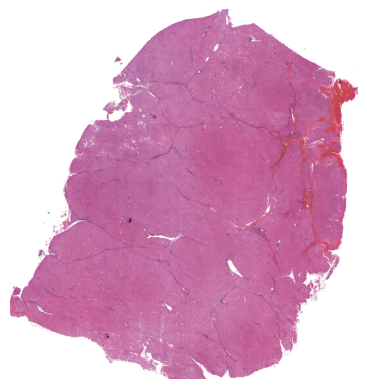

128


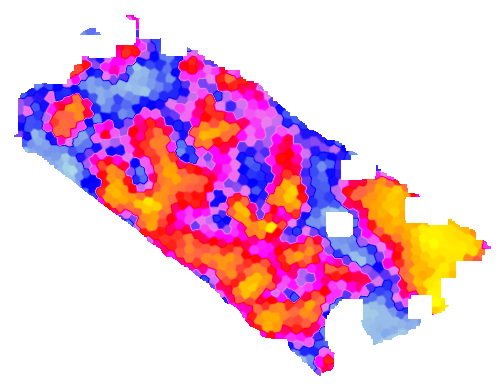

/mnt/s3/lhm/HCC_thumb/0/7M18.png


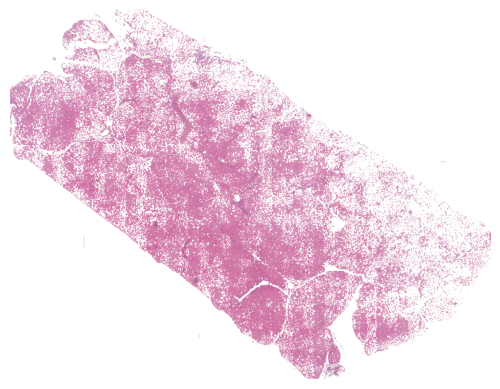

128


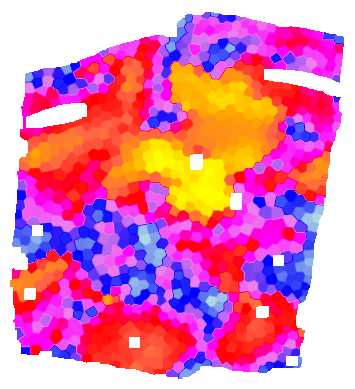

[ WARN:0@489.085] global loadsave.cpp:241 findDecoder imread_('/mnt/s3/lhm/HCC_thumb/2/1M12.png'): can't open/read file: check file path/integrity


/mnt/s3/lhm/HCC_thumb/2/1M12.png
'NoneType' object is not subscriptable
128


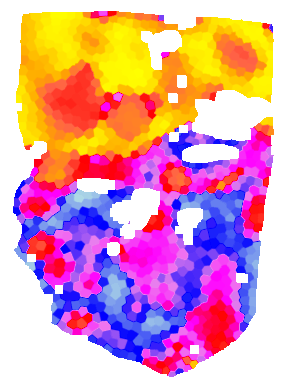

/mnt/s3/lhm/HCC_thumb/2/201132264.png


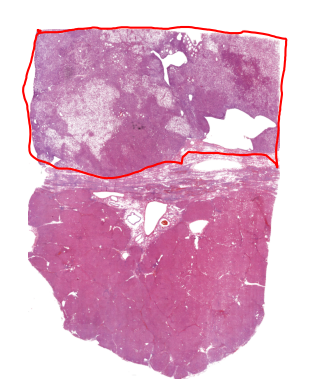

128


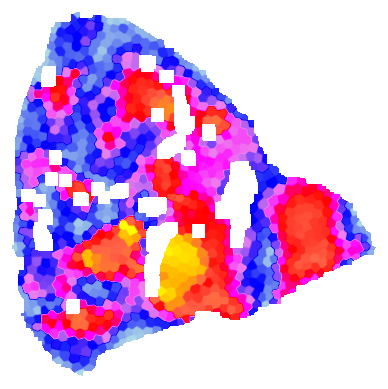

/mnt/s3/lhm/HCC_thumb/3/201202723.png


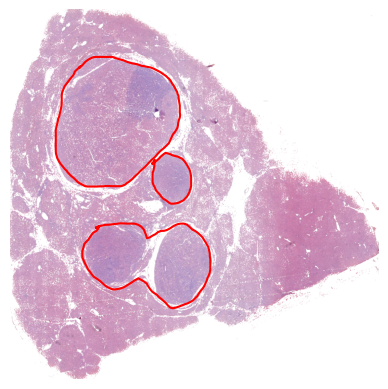

128


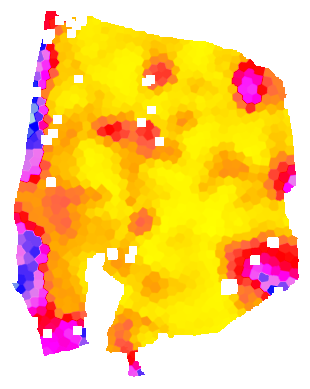

/mnt/s3/lhm/HCC_thumb/2/20130118.png


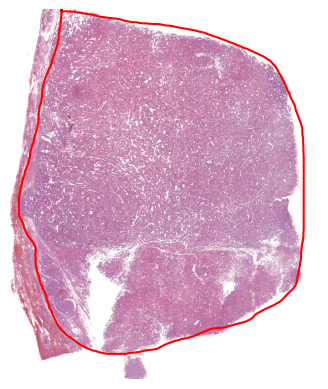

128


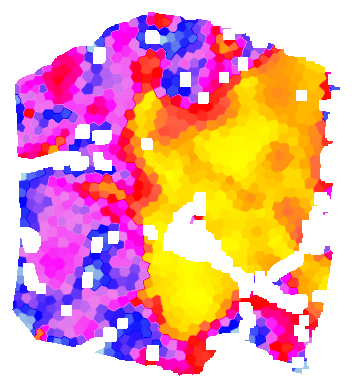

/mnt/s3/lhm/HCC_thumb/3/20111801.png


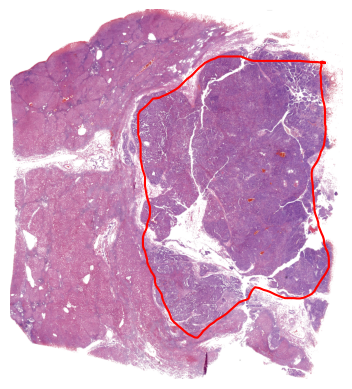

128


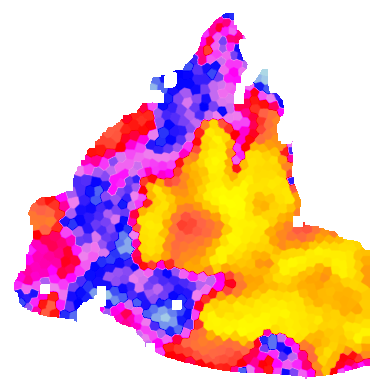

/mnt/s3/lhm/HCC_thumb/3/20124325.png


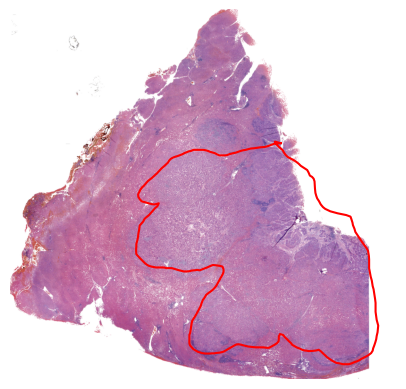

128


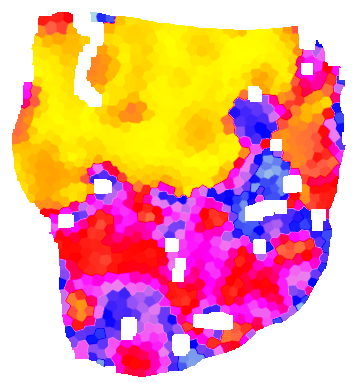

/mnt/s3/lhm/HCC_thumb/3/201140300.png


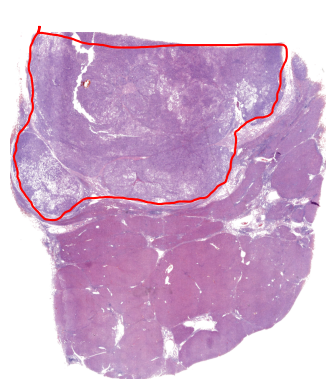

128


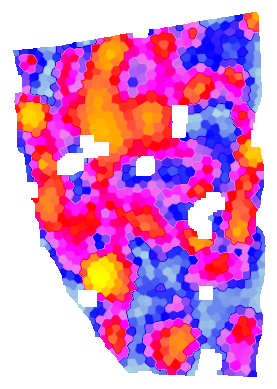

/mnt/s3/lhm/HCC_thumb/0/6M23.png


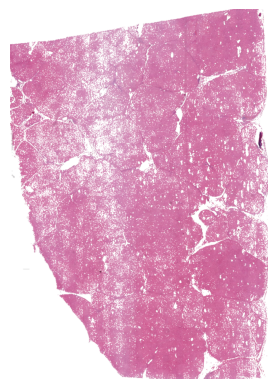

128


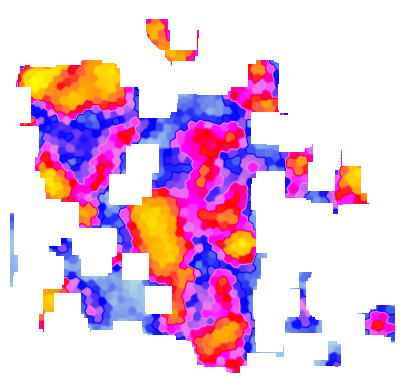

/mnt/s3/lhm/HCC_thumb/0/7M19.png


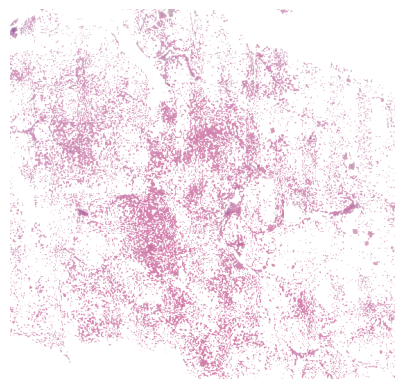

128


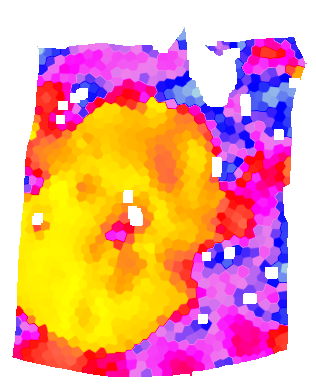

/mnt/s3/lhm/HCC_thumb/1/2020015.png


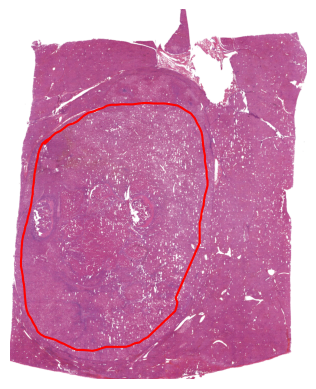

128


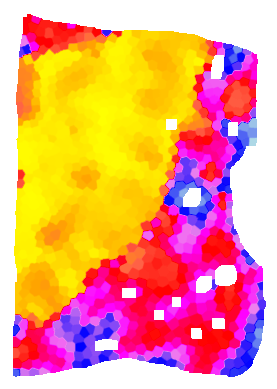

/mnt/s3/lhm/HCC_thumb/4/20190452.png


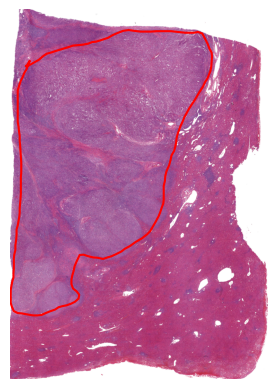

128


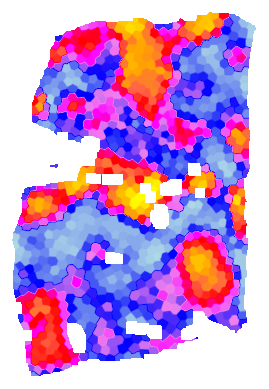

/mnt/s3/lhm/HCC_thumb/0/6M24.png


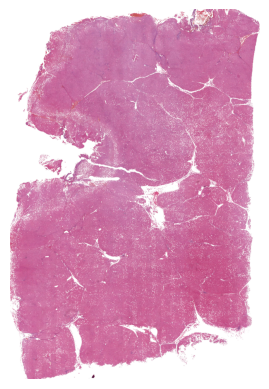

128


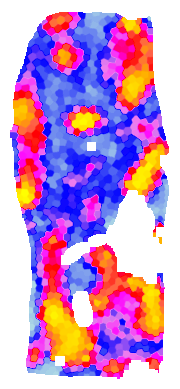

/mnt/s3/lhm/HCC_thumb/0/6M13.png


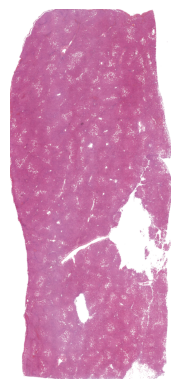

128


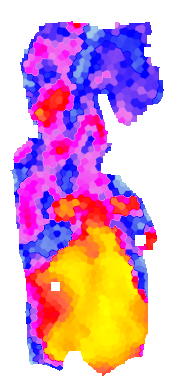

/mnt/s3/lhm/HCC_thumb/3/2013153.png


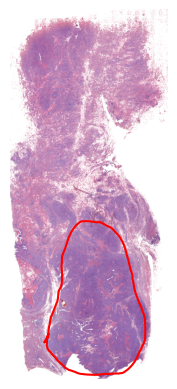

128


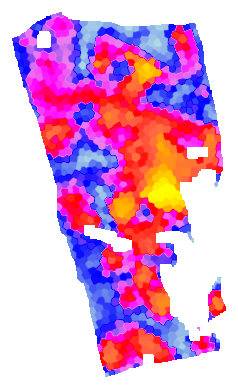

/mnt/s3/lhm/HCC_thumb/4/202003036.png


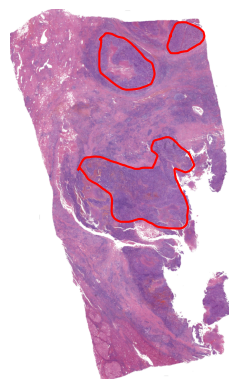

128


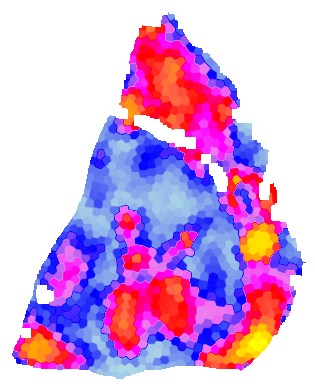

/mnt/s3/lhm/HCC_thumb/3/201129928.png


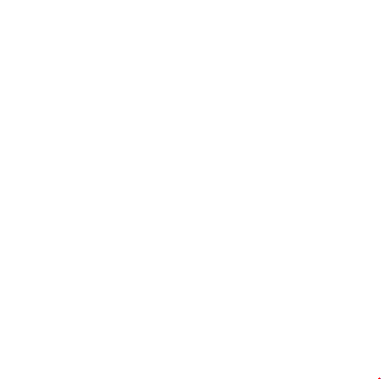

128


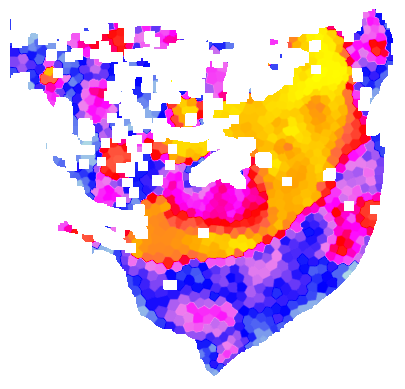

/mnt/s3/lhm/HCC_thumb/3/201365822.png


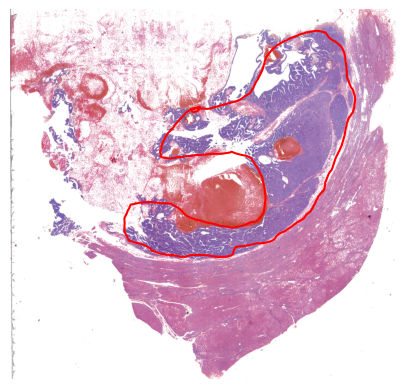

128


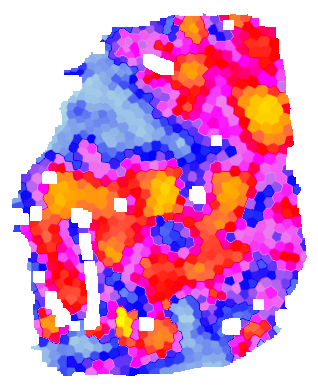

/mnt/s3/lhm/HCC_thumb/2/201109016.png


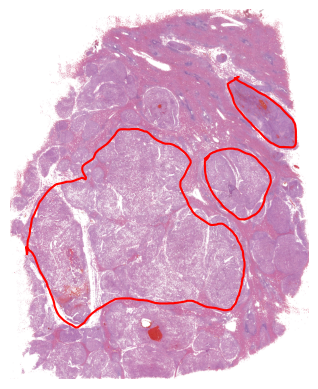

128


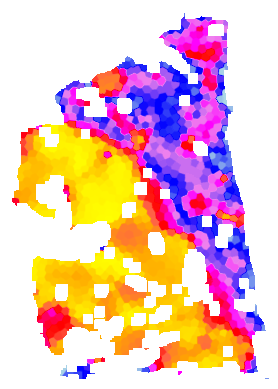

/mnt/s3/lhm/HCC_thumb/2/201356069.png


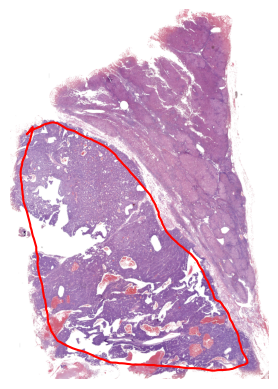

128


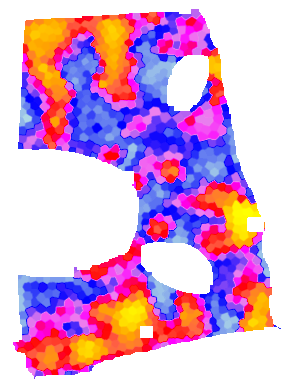

/mnt/s3/lhm/HCC_thumb/0/7M11.png


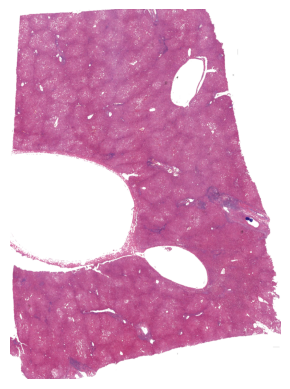

128


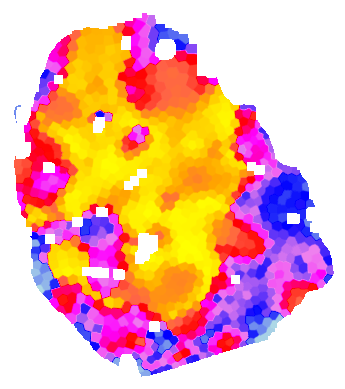

/mnt/s3/lhm/HCC_thumb/2/201308152.png


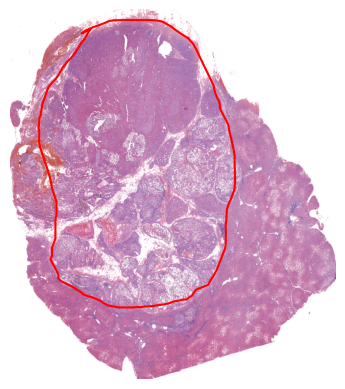

128


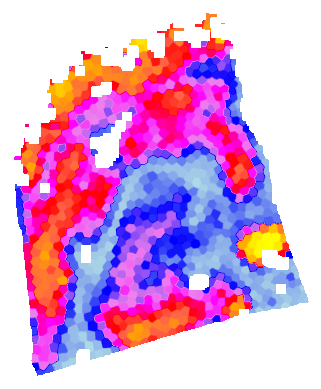

/mnt/s3/lhm/HCC_thumb/0/6M21.png


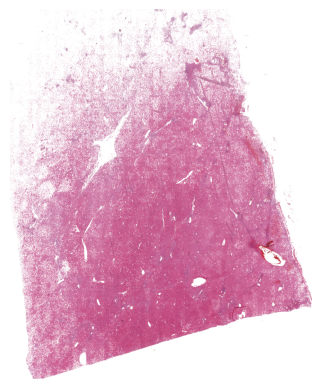

128


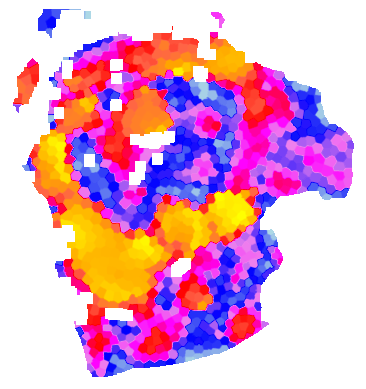

/mnt/s3/lhm/HCC_thumb/4/201134349.png


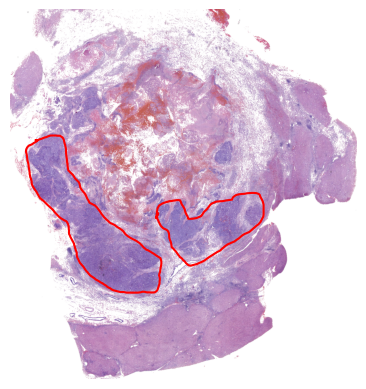

128


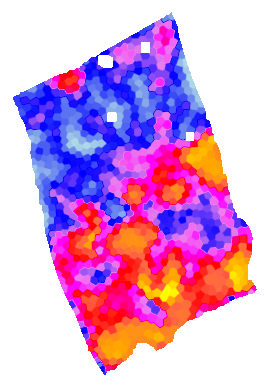

/mnt/s3/lhm/HCC_thumb/3/1M07.png
'NoneType' object is not subscriptable
128


[ WARN:0@539.897] global loadsave.cpp:241 findDecoder imread_('/mnt/s3/lhm/HCC_thumb/3/1M07.png'): can't open/read file: check file path/integrity


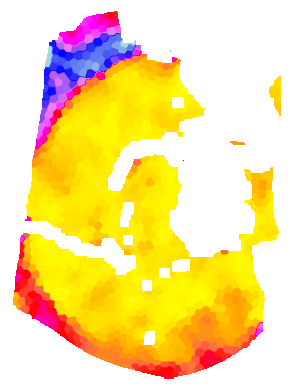

/mnt/s3/lhm/HCC_thumb/2/201136461.png


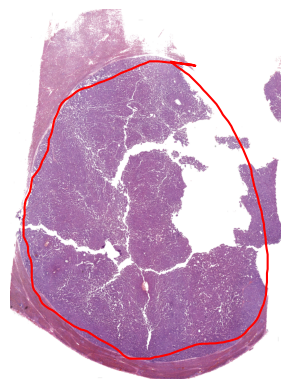

128


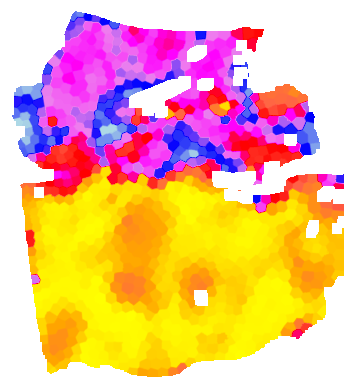

/mnt/s3/lhm/HCC_thumb/2/20131359.png


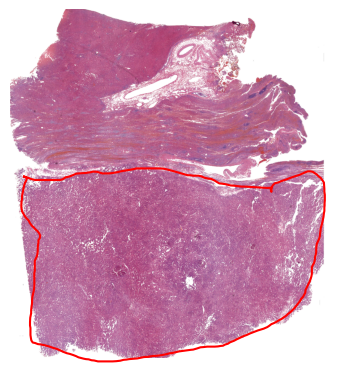

128


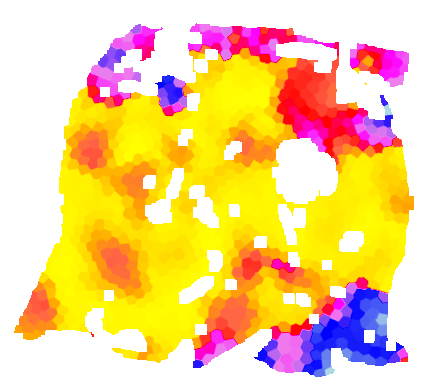

/mnt/s3/lhm/HCC_thumb/2/201154041.png


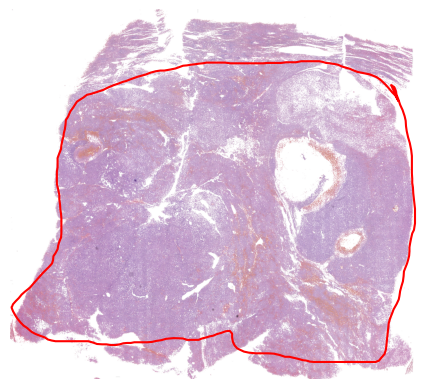

128


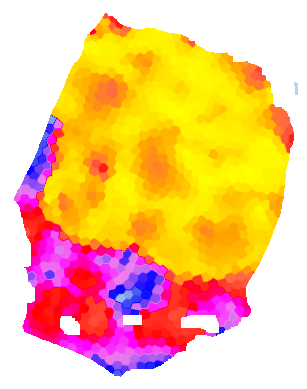

/mnt/s3/lhm/HCC_thumb/4/201912098.png


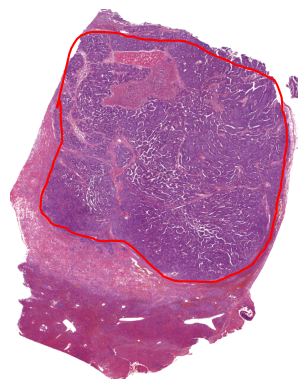

128


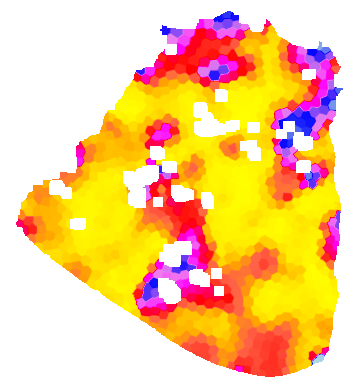

/mnt/s3/lhm/HCC_thumb/3/20112645.png


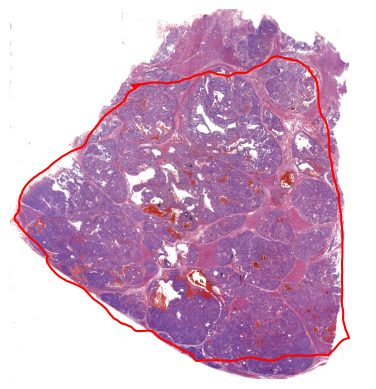

128


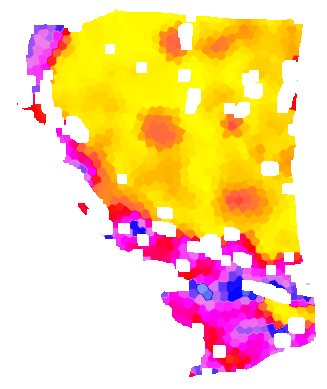

/mnt/s3/lhm/HCC_thumb/2/201200665-9.png


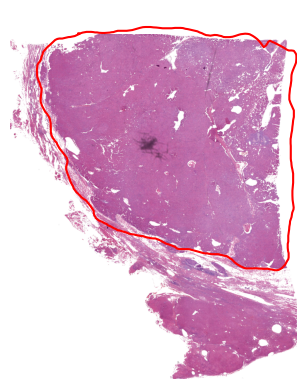

128


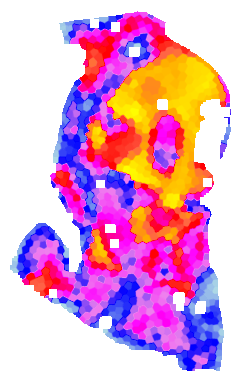

/mnt/s3/lhm/HCC_thumb/4/201337639.png


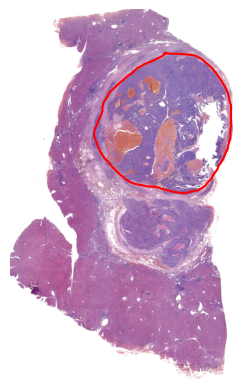

128


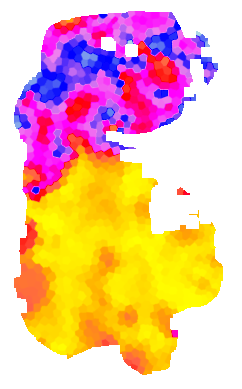

/mnt/s3/lhm/HCC_thumb/3/201216259-4.png


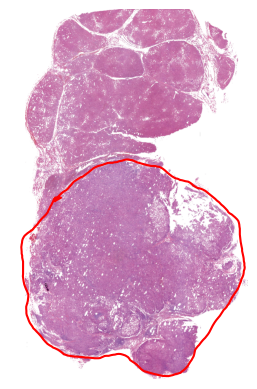

128


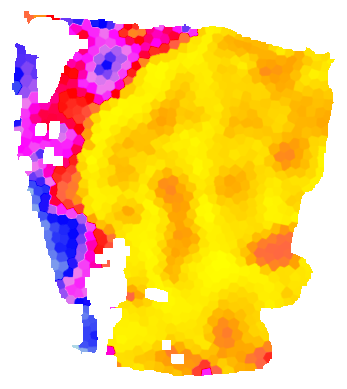

/mnt/s3/lhm/HCC_thumb/2/20120591-3.png


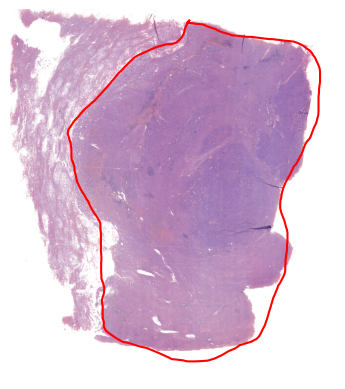

128


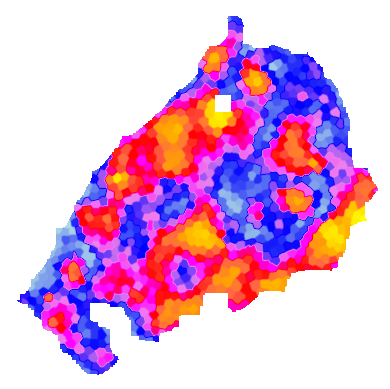

/mnt/s3/lhm/HCC_thumb/0/7M07.png


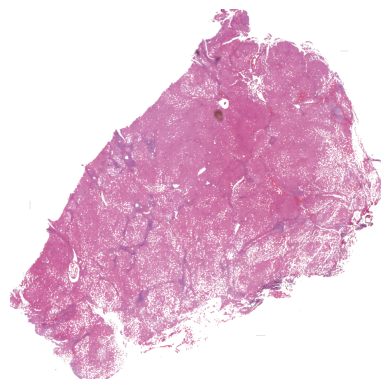

128


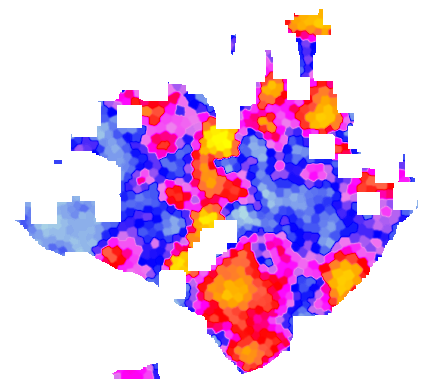

/mnt/s3/lhm/HCC_thumb/0/7M13.png


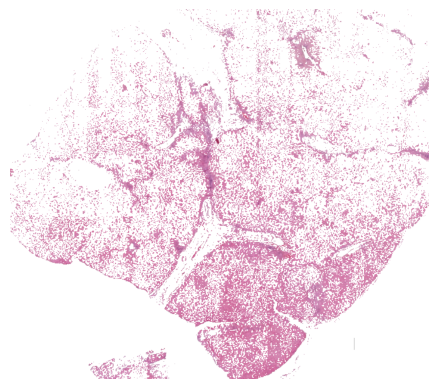

128


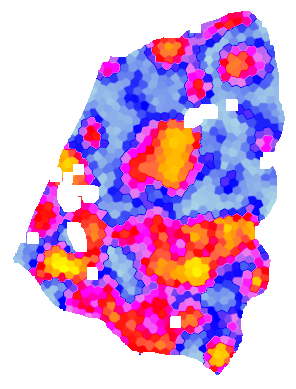

/mnt/s3/lhm/HCC_thumb/0/6M04.png


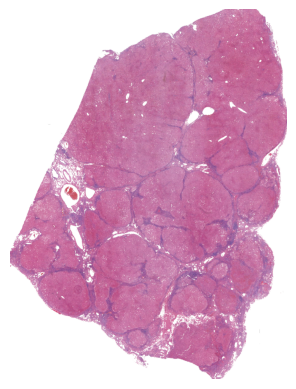

128


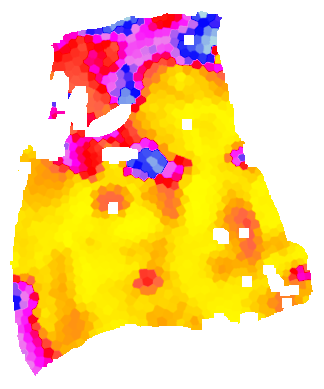

/mnt/s3/lhm/HCC_thumb/4/201108057.png


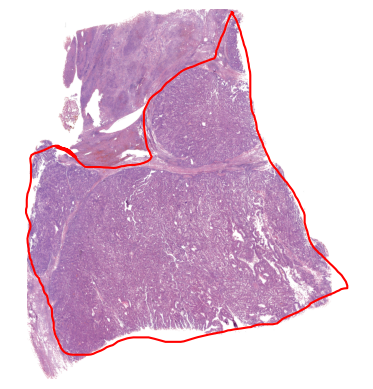

128


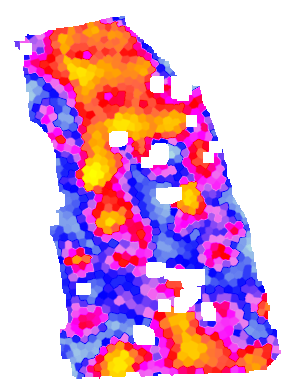

/mnt/s3/lhm/HCC_thumb/0/6M08.png


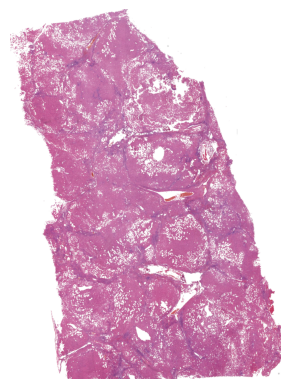

128


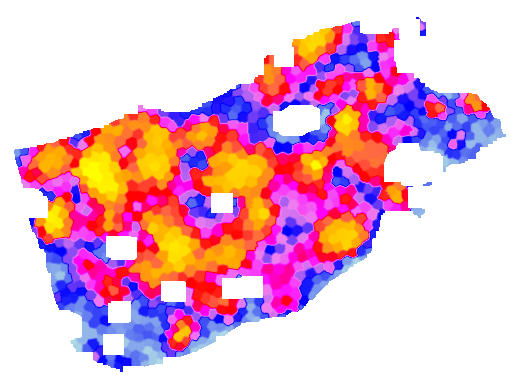

/mnt/s3/lhm/HCC_thumb/0/6M19.png


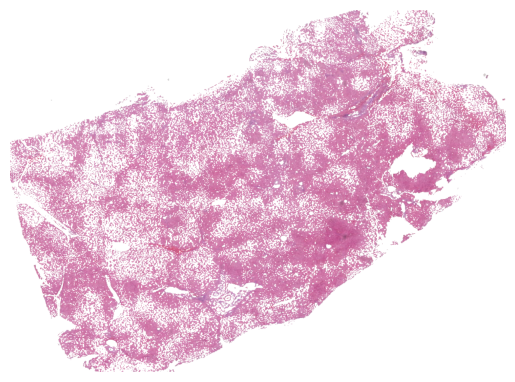

128


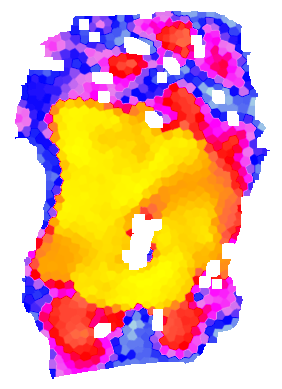

/mnt/s3/lhm/HCC_thumb/3/201360633.png


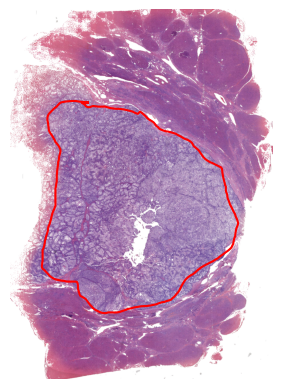

128


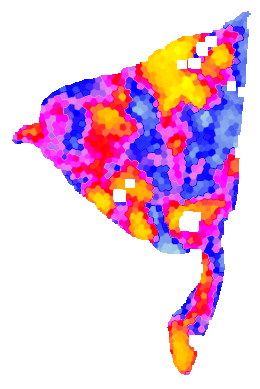

/mnt/s3/lhm/HCC_thumb/0/6M25.png


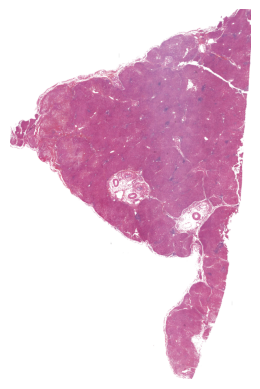

128


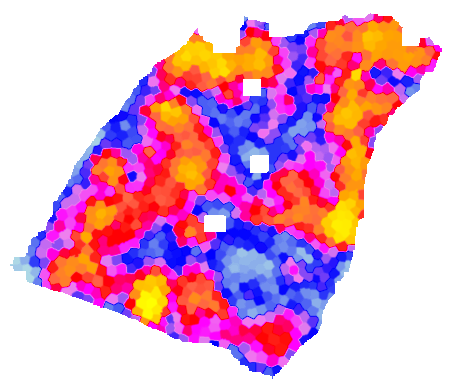

/mnt/s3/lhm/HCC_thumb/0/8M11.png


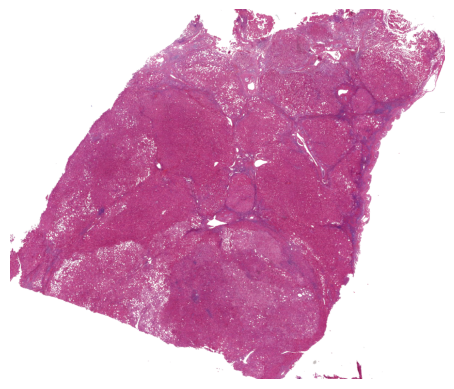

128


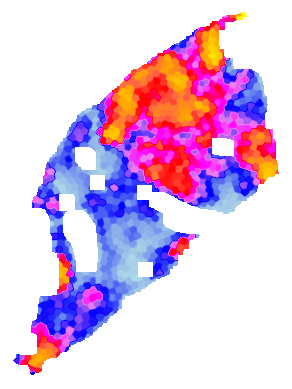

/mnt/s3/lhm/HCC_thumb/0/7M16.png


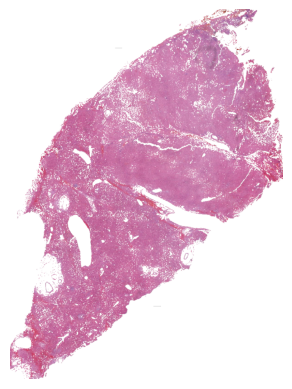

128


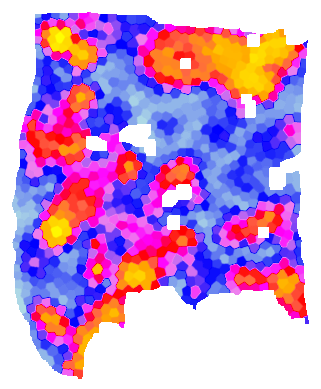

/mnt/s3/lhm/HCC_thumb/0/7M20.png


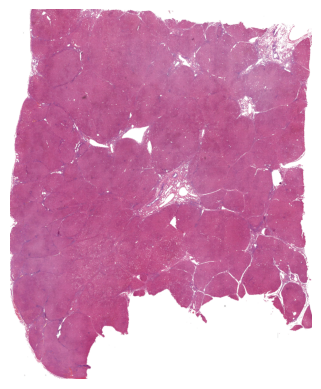

128


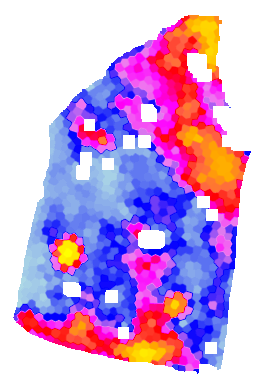

/mnt/s3/lhm/HCC_thumb/0/6M16.png


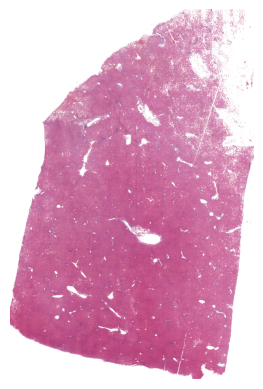

128


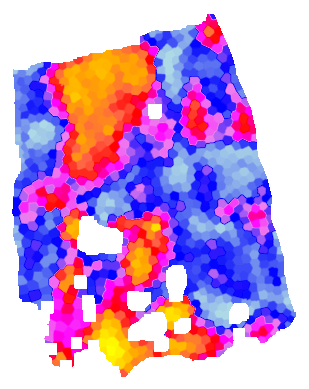

/mnt/s3/lhm/HCC_thumb/0/7M05.png


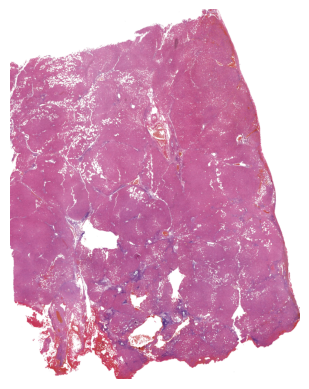

128


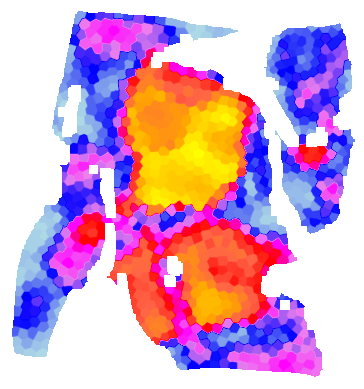

/mnt/s3/lhm/HCC_thumb/4/202000585.png


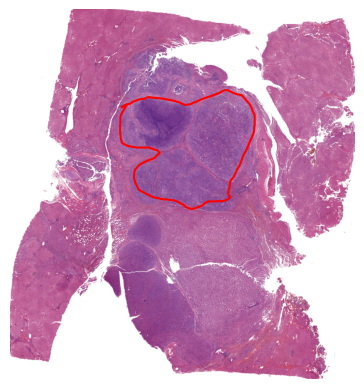

128


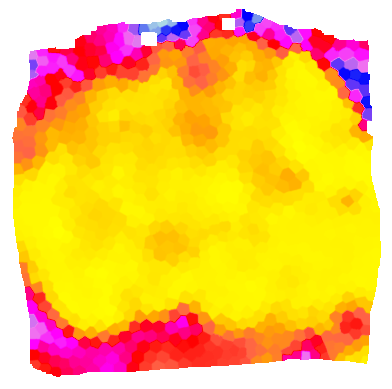

/mnt/s3/lhm/HCC_thumb/1/20191016.png


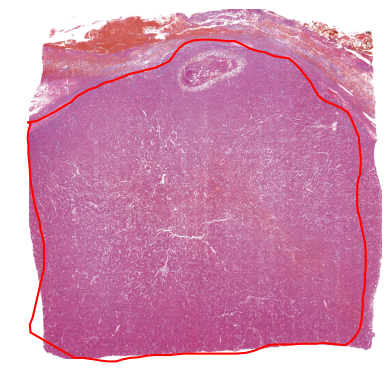

128


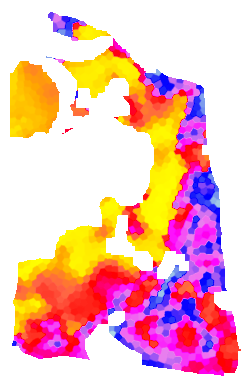

/mnt/s3/lhm/HCC_thumb/1/2019111673.png


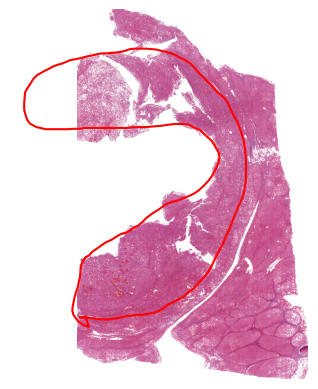

128


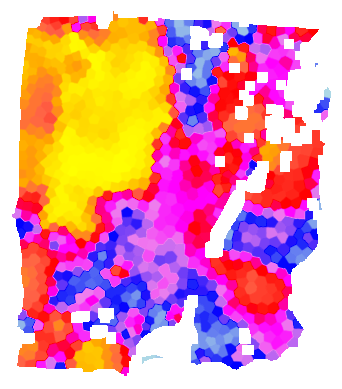

/mnt/s3/lhm/HCC_thumb/1/20130220.png


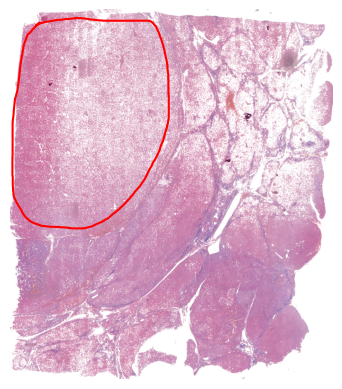

128


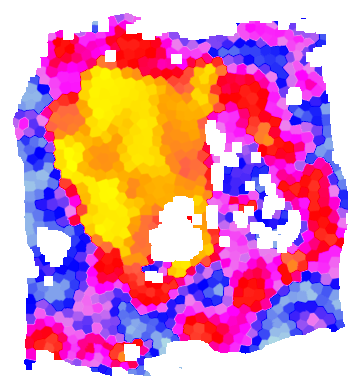

/mnt/s3/lhm/HCC_thumb/2/201130149.png


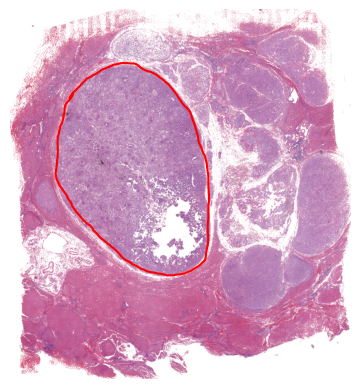

128


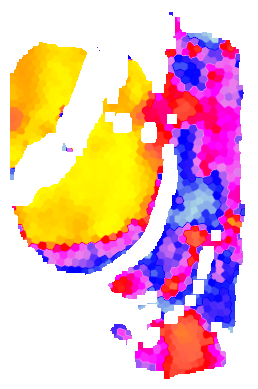

/mnt/s3/lhm/HCC_thumb/3/20120024.png


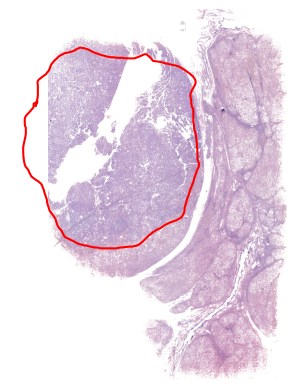

128


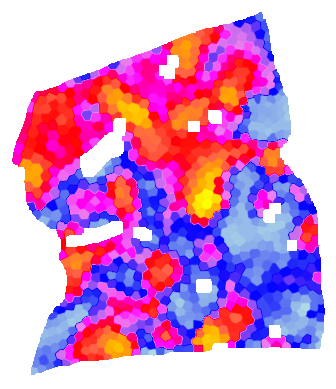

/mnt/s3/lhm/HCC_thumb/0/6M01.png


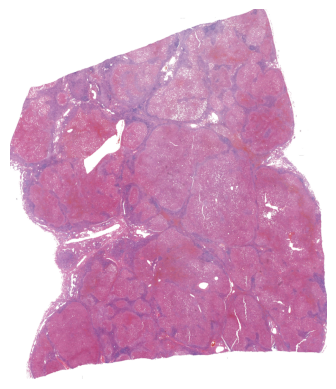

128


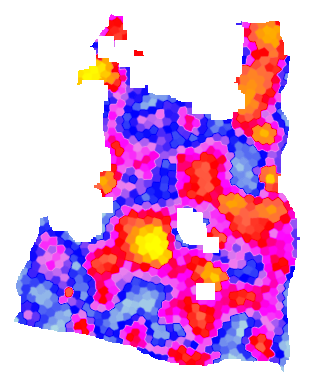

/mnt/s3/lhm/HCC_thumb/0/7M21.png


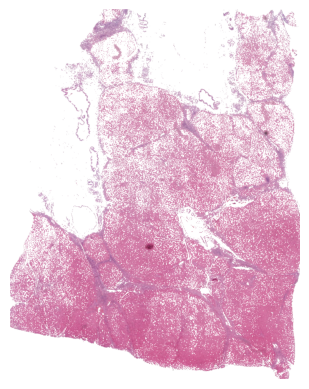

128


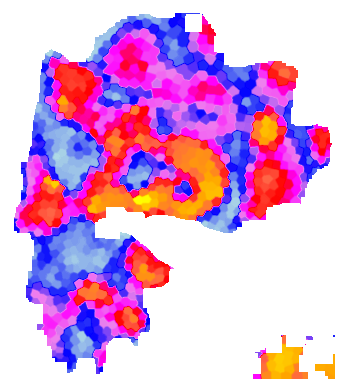

/mnt/s3/lhm/HCC_thumb/4/20112874.png


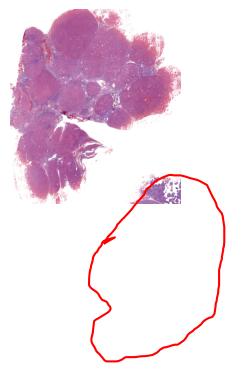

128


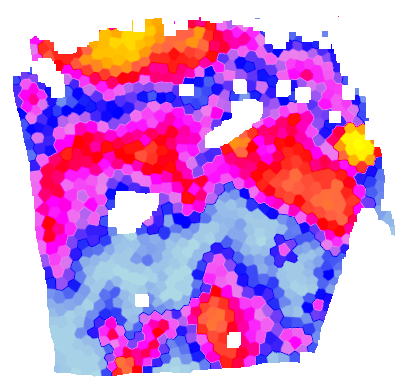

/mnt/s3/lhm/HCC_thumb/0/6M22.png


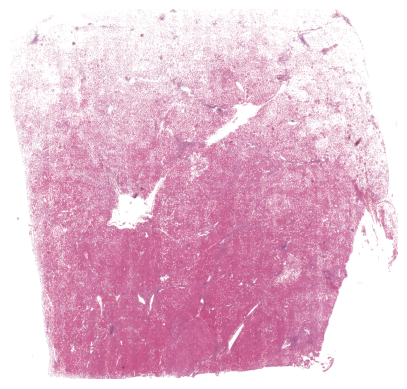

128


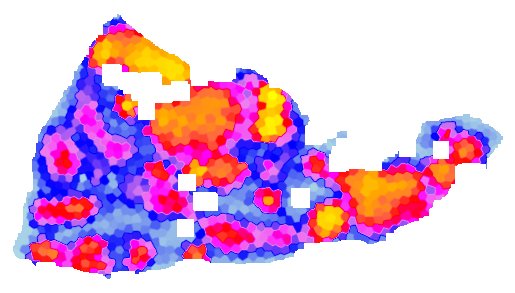

/mnt/s3/lhm/HCC_thumb/0/7M23.png


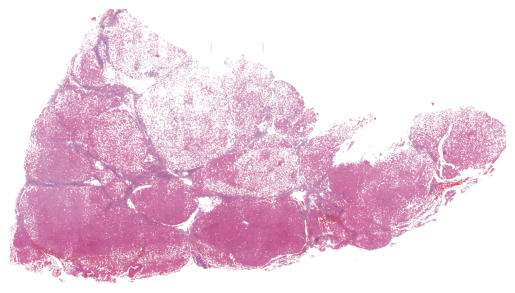

128


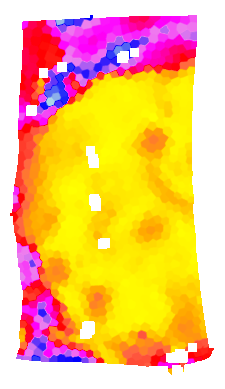

/mnt/s3/lhm/HCC_thumb/2/201251654.png


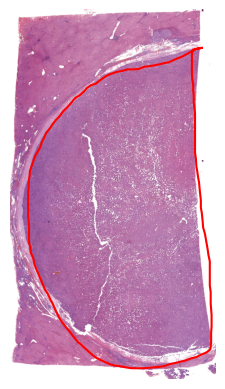

In [4]:
from scipy.ndimage import gaussian_filter
from matplotlib.colors import LinearSegmentedColormap

batch = None
for i, sample in enumerate(loader):
    print(len(loader))
    batch = sample
    node_y = batch.node_y.to(device)
    # if i == 6:  # 我们只需要第一个元素
    #     break  # 一旦找到第一个元素，就中断迭代  
    size = np.array(batch.patch_size[0])
    batch.x = batch.x.to(device)
    batch.edge_index = batch.edge_index.to(device)
    code = batch.code[0]
    # ===========stage1===============
    seg_map_stage_1 = np.load(f'{image_root}/{code}.npy')
    pred, feat = model1(batch)
    y1 = batch.y.long()
    y1 = y1.to(device)
    '''
    transformer 处理
    '''
    x_class_all, cls_token, x_class_node, attn, x_node = transformer1(feat)
    # for i in range(params['num_focus']):
    #     slide_name = medical_tag_path[i].split('/')[-1].split('.')[0]
    #     save_focus_map(stage_one_attention[i].cpu(), "/home/lhm/tmp/panda_test_focus/" + slide_name + '.png')
    g_attn1 = torch.autograd.grad(outputs=nn.Softmax(dim=1)(x_class_all)[:, 1].sum(),
                                  inputs=attn, retain_graph=True)[0]
    g_attn1 = g_attn1.sum(dim=(1, 2))[:, 1:]
    g_attn1 = g_attn1[0]
    x_class_node = x_class_node.squeeze()
    code_xml = code
    if 'M' in code and code[-1] == '-':
        code_xml = code[:-1]
    polygons = []
    if os.path.exists(slide_root + 'xml/' + f'{code_xml}_Annotations.xml'):
        polygons = read_points_from_xml(liver_name=f'{code_xml}_Annotations.xml', scale=64,
                                        xml_path=slide_root + 'xml/',
                                        dataset='HCC_LOWER')
    seg_map_stage_1 = np.load(f'{image_root}/{code}.npy')
    offset = batch.offset[0]
    colors = ['lightblue', 'blue', 'violet', 'magenta', 'red', 'tomato', 'orange', 'gold', 'yellow']
    # colors = ['red', 'orange', 'purple', 'blue']
    cmap = LinearSegmentedColormap.from_list('CustomMap', colors)
    # attn_score = draw_graph_attn(g_attn1, seg_map_stage_1)
    # # 应用高斯模糊
    # blurred_data = gaussian_filter(attn_score, sigma=1)
    # plt.imshow(blurred_data, interpolation='bilinear', cmap=cmap)
    # # plt.imshow(attn_score, cmap=cmap, interpolation='nearest')
    # plt.colorbar()
    # plt.show()

    focus_score = draw_graph_attn(x_class_node[:, 1], seg_map_stage_1)
    blurred_focus = gaussian_filter(focus_score, sigma=1)
    plt.imshow(blurred_focus, interpolation='bilinear', cmap=cmap)
    plt.axis('off')
    plt.show()
    # plt.imshow(focus_score, cmap='viridis')
    # sns.heatmap(focus_score,annot=False, cmap='viridis')
    # plt.colorbar()
    # plt.show()
    # true_label = draw_graph_attn(node_y, seg_map_stage_1)
    # plt.imshow(true_label, cmap='plasma')
    # plt.colorbar()
    # plt.show()
    try:
        img = cv2.imread(f'/mnt/s3/lhm/HCC_thumb/{y1.item()}/{code}.png')
        print(f'/mnt/s3/lhm/HCC_thumb/{y1.item()}/{code}.png')
        img = img[offset[0]:offset[0] + seg_map_stage_1.shape[0], offset[1]:offset[1] + seg_map_stage_1.shape[1], :]
        hsv_image = cv2.cvtColor(img, cv2.COLOR_BGR2HSV)
        lower_white = np.array([0, 0, 220])  # 假设threshold是一个你选择的值
        upper_white = np.array([180, 255, 255])
        lower_black = np.array([0, 0, 0])
        upper_black = np.array([180, 255, 50])
        # 创建掩模来分离白色和黑色背景
        mask1 = cv2.inRange(hsv_image, lower_white, upper_white)
        mask2 = cv2.inRange(hsv_image, lower_black, upper_black)
        # 使用 cv2.bitwise_or 来合并掩模
        mask = 255 - cv2.bitwise_or(mask1, mask2)
        img[mask == 0] = (255, 255, 255)
        plt.imshow(img)
        plt.axis('off')
        for pp in polygons:
            pp = np.array(pp) - [offset[1], offset[0]]
            plt.plot([p[0] for p in pp], [p[1] for p in pp], 'r-')
        plt.show()
    except Exception as e:
        print(e)

In [ ]:
selected_idx_stage_2 = torch.sort(g_attn1, descending=True)[1][:K].cpu()

centers_stage_2 = torch.stack([batch.pos[min(i, len(batch.pos) - 1)] for i in selected_idx_stage_2])
# if not os.path.exists(f'/nfs3/lhm/HCC/tmp/scale1-2/{code}'):
#     os.mkdir(f'/nfs3/lhm/HCC/tmp/scale1-2/{code}')
# img1 = cv2.imread(f'/nfs3/lhm/HCC/gnn_1/{code}.png')
# for p in centers_stage_2:
#     p = p.numpy().astype(np.int32)
#     p[[0, 1]] = p[[1, 0]]
#     cv2.rectangle(img1, p // 64 - 64, p // 64 + 64, color=(0, 255, 0), thickness=5)
# for p in neg_centers_stage_2:
#     p = p.numpy().astype(np.int32)
#     p[[0, 1]] = p[[1, 0]]
#     cv2.rectangle(img1, p // 64 - 64, p // 64 + 64, color=(255, 0, 0), thickness=5)
# cv2.imwrite(f'/nfs3/lhm/HCC/tmp/scale1-2/{code}/1.png', img1)
patches_2 = cut_patch_stage_2_single(centers_stage_2, slide_root + f'{y1.item()}/' + code + '.mrxs', size)
# for index, p in enumerate(patches_2):
#     cv2.imwrite(f'./2-pos-{index}.png', p)
# for index, p in enumerate(neg_patches_2):
#     cv2.imwrite(f'/nfs3/lhm/HCC/tmp/scale1-2/{code}/2-neg-{index}.png', p)
# # prepare to stage3
graphs_2 = []
seg_maps_2 = []
#
# for idx, patch in enumerate(patches_2):
#     g, seg_map = convert_numpy_img_to_superpixel_graph_2_single(patch, y1,
#                                                                 centers_stage_2[idx] - (1024 * 8 // 2),
#                                                                 seg_map_stage_1, batch.offset)

#     graphs_2.append(g)
#     seg_maps_2.append(seg_map)

res = multi_process_exec(convert_numpy_img_to_superpixel_graph_2_single,
                         list(zip(patches_2, repeat(y1.cpu().item()),
                                  centers_stage_2 - (1024 * 8 // 2), repeat(seg_map_stage_1),
                                  repeat(batch.offset), repeat(size))),
                         32)
graphs_2, seg_maps_2 = zip(*res)

centers_stage_3 = []
feat_all = []
group_ids = []

In [ ]:

for g, s in zip(graphs_2, seg_maps_2):
    gp = np.zeros(s.shape)
    for i in range(s.shape[0]):
        for j in range(s.shape[1]):
            gp[i][j] = int(g['group_id'][s[i][j]])
    x_dict = {}
    for idx, group_id in enumerate(g['group_id']):
        if group_id == -1:
            continue
        if group_id not in x_dict:
            x_dict[group_id] = 0
        x_dict[group_id] += 1
        # 将key和value数组的长度存储到列表中
    lengths = [(key, value) for key, value in x_dict.items()]

    # 根据数组长度降序排序
    lengths.sort(key=lambda x: x[1], reverse=True)

    # 选择前16个key
    x_group = [key for key, length in lengths[:16]]
    for key in x_group:
        print(x_dict[key])
    plt.imshow(gp)
    plt.show()



In [ ]:
for graph in graphs_2:
    graph.x = graph.x.to(device)
    graph.edge_index = graph.edge_index.to(device)
    pred, feat = model2(graph)
    y = graph.y.long().to(device)
    # feat是gcn之后的特征
    # loss = criterion(pred, y)
    # opt2.zero_grad()
    # loss.backward()
    # opt2.step()
    # pred_y = pred.argmax(dim=1)
    # acc = [(((pred_y == y) & (y == cls)).float().sum() / (
    #         (y == cls).float().sum() + 1e-6)).item() // 0.0001 / 100 for cls in range(2)]
    # print(
    #     f'epoch {epoch}: at {index} of {len(loader)} GCN2  stage2 acc {acc}  with gt {y.sum()}/{y.shape[0]}  pred {pred_y.sum()}/{pred_y.shape[0]}')
    # train_acc1.append(acc)

    '''
    graph transformer 2处理
    group_ids size n//strip =(16) 本 patch的 1024个节点 对应上层 16个节点 的 ids
    '''
    tx, group_ids = generate_transformer_input_and_its_groups_id_sequence(graph.group_id, feat)
    tx = tx.to(device)
    # t_out为 graph transformer 的输出，维度为 16+1024，前 16位为 cls token
    x_class_all, x_class_groups, x_class_node, cls_token_all, cls_token_groups, attn_group = graph_transformer_2(
        tx)
    cls_token_groups = cls_token_groups.squeeze()
    # pred = F.softmax(x_class_node.squeeze(0), dim=1)
    # g_attn = torch.autograd.grad(outputs=nn.Softmax(dim=1)(x_class_all)[:, 1].sum(),
    #                              inputs=attn_group, retain_graph=True)[0]
    attn_group = attn_group.sum(dim=(1, 2))
    attn_group = attn_group.squeeze()
    '''
    聚类处理
    '''
    k_out = get_nodes_group_composition(feat, graph.group_id, 10, device)
    # 注意，这里 cls-token中包含的 group id 最大为16个(可能不足 16个，这种情况下 cls-token是采用 padding 的方式构成 16*512的形状)，极有可能与 k_out
    # 中包含的维度不相符合，需要和 groups_ids对齐

    feat_final = merge_t_out_and_k_out(cls_token_groups, k_out, group_ids)
    kt_group_cls = F.softmax(final_clsfr2(feat_final), dim=1)
    '''
    指标测试
    '''
    loss = (criterion(x_class_all, y1)  # cls all损失
            + criterion(kt_group_cls, y1.repeat(16))  # cls group 损失
            ) / K
    loss.backward()
    train_acc2(x_class_all, y1)
    selected_idx_stage_3 = torch.sort(attn_group, descending=True)[1][:K].cpu()
    pos_idx = [group_ids[i] for i in selected_idx_stage_3]

    centers_stage_3.extend([batch.pos[i] for i in pos_idx])
centers_stage_3 = torch.stack(centers_stage_3)

In [ ]:
img = cv2.imread(f'/mnt/s3/lhm/HCC_thumb/{y1.item()}/{code}.png')
plt.imshow(img)
# x,y = zip(*np.array(centers_stage_2//64))
# print((y,x))
# plt.scatter(y,x)
# plt.show()
for p in np.array(centers_stage_2 // 64):
    x0, y0 = p[1] + size[1] // 8, p[0]  # 左下角坐标
    x1, y1 = p[1], p[0] + size[0] // 8  # 右上角坐标
    # 绘制矩形的边界
    plt.plot([x0, x1, x1, x0, x0], [y0, y0, y1, y1, y0], 'r-')  # 'r-' 表示红色实线
# 显示图表
plt.show()
plt.imshow(img)

In [ ]:
for p in patches_2:
    plt.imshow(p)
    plt.show()

In [ ]:
for g in graphs_2:
    break
np.unique(g.group_id).shape


In [ ]:
import cv2

a = np.zeros()
b = cv2.resize(a, size)